In [ ]:
import gensim
from bokeh.layouts import gridplot, row, column
from gensim.corpora import Dictionary
from gensim.models import TfidfModel, CoherenceModel
from gensim.parsing.preprocessing import STOPWORDS
from nltk import sent_tokenize, word_tokenize, WordNetLemmatizer, PorterStemmer, text
import pandas as pd
import matplotlib.pyplot as plt
from textblob import TextBlob
from bokeh.plotting import output_file , figure ,show
sentence= []
rm_stop = []
li = []
stop = ['fellow','countrymen', 'dear', 'greetings','new','feel','dirt','need','days','years','baat','world','babasaheb', 'ambedkar', 'mann','country','india','world' 'namaskar', 'feeling', 'like', 'today','day','year']
wordnet_lemmatizer = WordNetLemmatizer()
output_file('plot.html')
#layout = gridplot()



In [ ]:
def load():
    df = pd.read_csv("MKB.csv")
    for i in range(0, len(df)):
        topic(df, i)

In [ ]:
cd drive/MyDrive/DSProj/Datasets/

/content/drive/MyDrive/DSProj/Datasets


In [ ]:
ls

cleaned_tweets48.csv  etl_twitter.py  mkb_speech_raw.json  tweets48.json
cleaner.py            MKB.csv         plot.html            twitter_data.png


In [ ]:
def topic(df1,k):
    print(k)
    p = figure(title="Graphical representation of Topics", x_axis_label='Topic', y_axis_label='Value',plot_width=400 , plot_height = 400)
    valuelist = []
    strlist = []
    tokens = []
    lemmatized = []
    final = []
    c = 0
    speech = df1['Cleaned_content'][k]
    blob = TextBlob(speech)
    noun =  blob.noun_phrases
    stemmer = PorterStemmer()
    sent= [w for w in sent_tokenize(speech.lower())]
    for i in range(0, len(sent)):
        tokens.append([w for w in word_tokenize(sent[i].lower()) if w.isalpha() and w not in STOPWORDS and not len(w)<=2 and w not in stop and w not in noun])
    for i in tokens:
        lemm = [wordnet_lemmatizer.lemmatize(t) for t in i]
        lemmatized.append(lemm)
    dictionary = Dictionary(lemmatized)
    corpus = [dictionary.doc2bow(doc) for doc in lemmatized]
    '''tfidf = TfidfModel(corpus)
    corpus_tfidf = tfidf[corpus[0]]
    sorted_tfidf = sorted(corpus_tfidf, key=lambda w: w[1], reverse=True)
    for term_id, weight in sorted_tfidf:
        strlist.append(dictionary.get(term_id))
        valuelist.append(weight)
    #plt.barh(strlist, valuelist)
    #plt.show()'''
    t = 0
    lda_model = gensim.models.LdaMulticore(corpus,num_topics=10, id2word=dictionary, passes=2)
    K = lda_model.num_topics
    topicWordProbMat = sorted(lda_model.print_topics(K), key=lambda tup: tup[1], reverse=True)
    #print(topicWordProbMat)
    for line in topicWordProbMat:
           tp, w = line
           probs = w.split("+")
           y=0
           test = []
           #print("TOTal = ",len(probs))
           for pr in probs:
                #print(pr)
                test.append(pr)
                a = pr.split("*")
                valuelist.append(float(a[0]))
                y += 1
                strlist.append(y)
                c = c + 1
                #yr = str(df1['year'][k])
                #mon = str(df1['month'][k])
                ep = str(df1['Episode'][k])
                #plt.title(ep)
                #plt.xlabel("Value")
                #plt.ylabel("Topic")
                if(c>10):
                    break
           final.append(test)
    print(valuelist)
    print(strlist)
    plt.barh(strlist,valuelist,color='r')
    plt.show()
    p.hbar(y=valuelist,
           height=0.1,
           left=0,
           right=strlist,
           color="navy")
    p.xgrid.grid_line_color = None
    p.y_range.start = 0
    #layout = row(p)
    #show(layout)
    #plt.barh(strlist, valuelist, color='g',alpha=0.6)
   # plt.show()
    print(final)


0
[0.016, 0.014, 0.013, 0.009, 0.009, 0.008, 0.008, 0.006, 0.006, 0.005, 0.009, 0.007, 0.007, 0.007, 0.007, 0.006, 0.006, 0.005, 0.005]
[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 1, 1, 1, 1, 1, 1, 1, 1, 1]


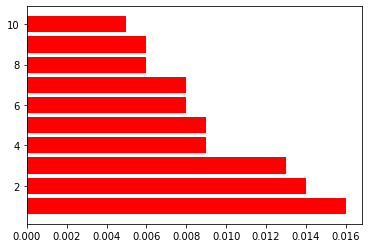

[['0.016*"people" ', ' 0.014*"poonam" ', ' 0.013*"drone" ', ' 0.009*"friend" ', ' 0.009*"sir" ', ' 0.008*"woman" ', ' 0.008*"police" ', ' 0.006*"yes" ', ' 0.006*"vaccine" ', ' 0.005*"nation"'], ['0.009*"people" '], ['0.007*"people" '], ['0.007*"people" '], ['0.007*"people" '], ['0.007*"people" '], ['0.006*"poonam" '], ['0.006*"people" '], ['0.005*"poonam" '], ['0.005*"drone" ']]
1
[0.018, 0.01, 0.009, 0.008, 0.007, 0.007, 0.006, 0.006, 0.006, 0.006, 0.018, 0.017, 0.012, 0.009, 0.007, 0.007, 0.007, 0.006, 0.006]
[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 1, 1, 1, 1, 1, 1, 1, 1, 1]


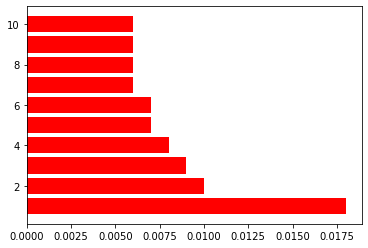

[['0.018*"river" ', ' 0.010*"people" ', ' 0.009*"cleanliness" ', ' 0.008*"time" ', ' 0.007*"campaign" ', ' 0.007*"water" ', ' 0.006*"know" ', ' 0.006*"friend" ', ' 0.006*"life" ', ' 0.006*"plant"'], ['0.018*"river" '], ['0.017*"river" '], ['0.012*"river" '], ['0.009*"river" '], ['0.007*"river" '], ['0.007*"river" '], ['0.007*"river" '], ['0.006*"river" '], ['0.006*"river" ']]
2
[0.013, 0.009, 0.009, 0.009, 0.007, 0.007, 0.007, 0.007, 0.007, 0.006, 0.008, 0.007, 0.006, 0.006, 0.005, 0.005, 0.005, 0.004, 0.004]
[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 1, 1, 1, 1, 1, 1, 1, 1, 1]


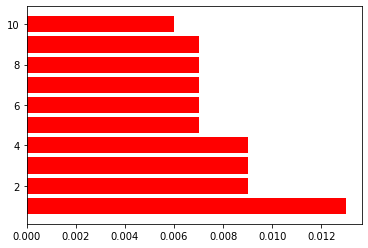

[['0.013*"sanskrit" ', ' 0.009*"bhagwan" ', ' 0.009*"people" ', ' 0.009*"sport" ', ' 0.007*"vishwakarma" ', ' 0.007*"village" ', ' 0.007*"friend" ', ' 0.007*"skill" ', ' 0.007*"time" ', ' 0.006*"life"'], ['0.008*"sanskrit" '], ['0.007*"sanskrit" '], ['0.006*"sanskrit" '], ['0.006*"sanskrit" '], ['0.005*"sport" '], ['0.005*"sanskrit" '], ['0.005*"people" '], ['0.004*"sanskrit" '], ['0.004*"bhagwan" ']]
3
[0.015, 0.012, 0.009, 0.008, 0.006, 0.006, 0.006, 0.005, 0.005, 0.005, 0.012, 0.007, 0.006, 0.006, 0.006, 0.006, 0.005, 0.005, 0.004]
[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 1, 1, 1, 1, 1, 1, 1, 1, 1]


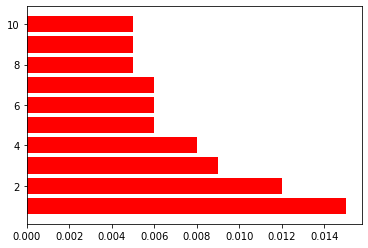

[['0.015*"friend" ', ' 0.012*"people" ', ' 0.009*"effort" ', ' 0.008*"technology" ', ' 0.006*"time" ', ' 0.006*"house" ', ' 0.006*"apple" ', ' 0.005*"work" ', ' 0.005*"project" ', ' 0.005*"georgia"'], ['0.012*"friend" '], ['0.007*"friend" '], ['0.006*"people" '], ['0.006*"friend" '], ['0.006*"friend" '], ['0.006*"friend" '], ['0.005*"friend" '], ['0.005*"friend" '], ['0.004*"friend" ']]
4
[0.026, 0.019, 0.018, 0.017, 0.015, 0.01, 0.01, 0.01, 0.009, 0.009, 0.019, 0.012, 0.012, 0.012, 0.01, 0.009, 0.009, 0.008, 0.005]
[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 1, 1, 1, 1, 1, 1, 1, 1, 1]


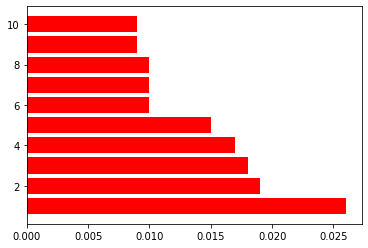

[['0.026*"people" ', ' 0.019*"kishorilal" ', ' 0.018*"sir" ', ' 0.017*"village" ', ' 0.015*"rajesh" ', ' 0.010*"corona" ', ' 0.010*"friend" ', ' 0.010*"prime" ', ' 0.009*"minister" ', ' 0.009*"vaccine"'], ['0.019*"people" '], ['0.012*"sir" '], ['0.012*"people" '], ['0.012*"people" '], ['0.010*"people" '], ['0.009*"people" '], ['0.009*"people" '], ['0.008*"people" '], ['0.005*"people" ']]
5
[0.022, 0.021, 0.018, 0.015, 0.014, 0.012, 0.012, 0.01, 0.009, 0.008, 0.015, 0.013, 0.012, 0.011, 0.011, 0.009, 0.008, 0.008, 0.005]
[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 1, 1, 1, 1, 1, 1, 1, 1, 1]


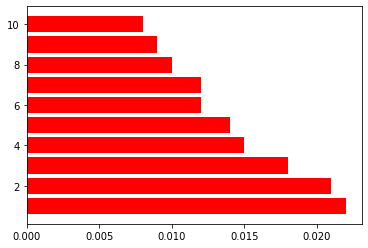

[['0.022*"sir" ', ' 0.021*"modi" ', ' 0.018*"oxygen" ', ' 0.015*"work" ', ' 0.014*"people" ', ' 0.012*"dinesh" ', ' 0.012*"time" ', ' 0.010*"corona" ', ' 0.009*"friend" ', ' 0.008*"yes"'], ['0.015*"oxygen" '], ['0.013*"sir" '], ['0.012*"sir" '], ['0.011*"sir" '], ['0.011*"modi" '], ['0.009*"sir" '], ['0.008*"oxygen" '], ['0.008*"oxygen" '], ['0.005*"modi" ']]
6
[0.025, 0.023, 0.018, 0.014, 0.014, 0.012, 0.012, 0.012, 0.011, 0.011, 0.017, 0.013, 0.013, 0.012, 0.011, 0.009, 0.008, 0.006, 0.006]
[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 1, 1, 1, 1, 1, 1, 1, 1, 1]


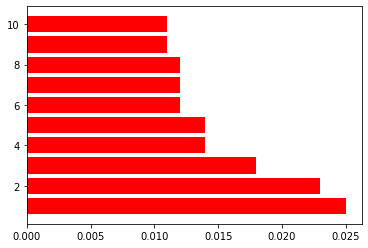

[['0.025*"modi" ', ' 0.023*"sir" ', ' 0.018*"people" ', ' 0.014*"prem" ', ' 0.014*"yes" ', ' 0.012*"patient" ', ' 0.012*"corona" ', ' 0.012*"covid" ', ' 0.011*"vaccine" ', ' 0.011*"preeti"'], ['0.017*"modi" '], ['0.013*"sir" '], ['0.013*"modi" '], ['0.012*"modi" '], ['0.011*"modi" '], ['0.009*"sir" '], ['0.008*"people" '], ['0.006*"modi" '], ['0.006*"modi" ']]
7
[0.014, 0.014, 0.013, 0.009, 0.007, 0.007, 0.006, 0.006, 0.006, 0.005, 0.008, 0.008, 0.007, 0.006, 0.006, 0.006, 0.005, 0.005, 0.004]
[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 1, 1, 1, 1, 1, 1, 1, 1, 1]


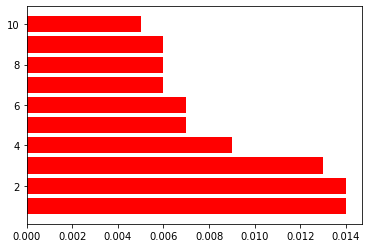

[['0.014*"house" ', ' 0.014*"light" ', ' 0.013*"time" ', ' 0.009*"people" ', ' 0.007*"effort" ', ' 0.007*"honey" ', ' 0.006*"work" ', ' 0.006*"friend" ', ' 0.006*"farmer" ', ' 0.005*"amrit"'], ['0.008*"light" '], ['0.008*"house" '], ['0.007*"house" '], ['0.006*"time" '], ['0.006*"light" '], ['0.006*"house" '], ['0.005*"house" '], ['0.005*"house" '], ['0.004*"house" ']]
8
[0.016, 0.013, 0.011, 0.008, 0.007, 0.006, 0.006, 0.006, 0.005, 0.005, 0.008, 0.007, 0.007, 0.007, 0.007, 0.006, 0.006, 0.006, 0.005]
[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 1, 1, 1, 1, 1, 1, 1, 1, 1]


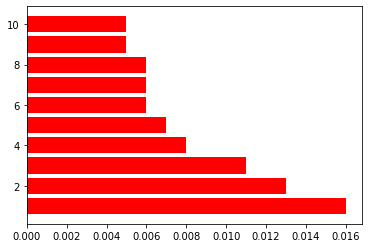

[['0.016*"water" ', ' 0.013*"people" ', ' 0.011*"friend" ', ' 0.008*"ravidas" ', ' 0.007*"way" ', ' 0.006*"time" ', ' 0.006*"commentary" ', ' 0.006*"month" ', ' 0.005*"lot" ', ' 0.005*"youth"'], ['0.008*"water" '], ['0.007*"water" '], ['0.007*"water" '], ['0.007*"water" '], ['0.007*"water" '], ['0.006*"water" '], ['0.006*"people" '], ['0.006*"people" '], ['0.005*"people" ']]
9
[0.011, 0.009, 0.007, 0.007, 0.006, 0.006, 0.006, 0.005, 0.005, 0.005, 0.009, 0.005, 0.005, 0.004, 0.004, 0.004, 0.003, 0.003, 0.003]
[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 1, 1, 1, 1, 1, 1, 1, 1, 1]


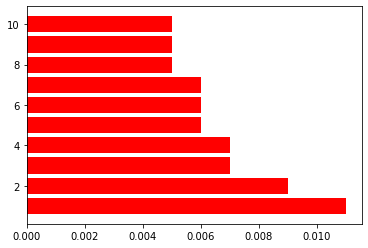

[['0.011*"time" ', ' 0.009*"friend" ', ' 0.007*"yoga" ', ' 0.007*"effort" ', ' 0.006*"village" ', ' 0.006*"know" ', ' 0.006*"started" ', ' 0.005*"woman" ', ' 0.005*"january" ', ' 0.005*"strawberry"'], ['0.009*"friend" '], ['0.005*"time" '], ['0.005*"time" '], ['0.004*"time" '], ['0.004*"time" '], ['0.004*"friend" '], ['0.003*"time" '], ['0.003*"time" '], ['0.003*"time" ']]
10
[0.015, 0.011, 0.008, 0.007, 0.007, 0.006, 0.006, 0.005, 0.005, 0.005, 0.007, 0.007, 0.006, 0.005, 0.005, 0.005, 0.005, 0.004, 0.003]
[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 1, 1, 1, 1, 1, 1, 1, 1, 1]


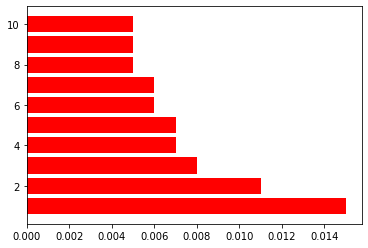

[['0.015*"people" ', ' 0.011*"saffron" ', ' 0.008*"friend" ', ' 0.007*"written" ', ' 0.007*"life" ', ' 0.006*"guru" ', ' 0.006*"temple" ', ' 0.005*"kashmir" ', ' 0.005*"leopard" ', ' 0.005*"letter"'], ['0.007*"people" '], ['0.007*"people" '], ['0.006*"people" '], ['0.005*"saffron" '], ['0.005*"people" '], ['0.005*"people" '], ['0.005*"people" '], ['0.004*"people" '], ['0.003*"people" ']]
11
[0.013, 0.009, 0.008, 0.008, 0.007, 0.007, 0.007, 0.007, 0.006, 0.006, 0.006, 0.006, 0.006, 0.006, 0.005, 0.004, 0.004, 0.004, 0.003]
[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 1, 1, 1, 1, 1, 1, 1, 1, 1]


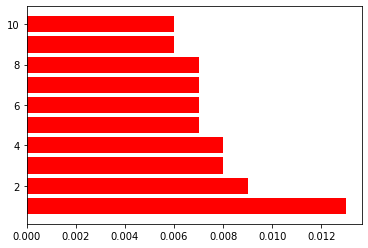

[['0.013*"farmer" ', ' 0.009*"guru" ', ' 0.008*"friend" ', ' 0.008*"sahib" ', ' 0.007*"institution" ', ' 0.007*"student" ', ' 0.007*"people" ', ' 0.007*"alumnus" ', ' 0.006*"effort" ', ' 0.006*"opportunity"'], ['0.006*"farmer" '], ['0.006*"farmer" '], ['0.006*"farmer" '], ['0.006*"farmer" '], ['0.005*"farmer" '], ['0.004*"guru" '], ['0.004*"farmer" '], ['0.004*"farmer" '], ['0.003*"farmer" ']]
12
[0.011, 0.01, 0.009, 0.009, 0.008, 0.008, 0.007, 0.007, 0.006, 0.006, 0.011, 0.009, 0.005, 0.005, 0.004, 0.004, 0.004, 0.004, 0.003]
[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 1, 1, 1, 1, 1, 1, 1, 1, 1]


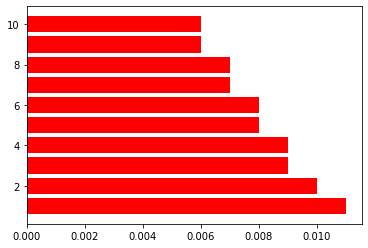

[['0.011*"khadi" ', ' 0.010*"people" ', ' 0.009*"friend" ', ' 0.009*"time" ', ' 0.008*"farmer" ', ' 0.008*"unity" ', ' 0.007*"library" ', ' 0.007*"festival" ', ' 0.006*"local" ', ' 0.006*"pon"'], ['0.011*"friend" '], ['0.009*"people" '], ['0.005*"people" '], ['0.005*"people" '], ['0.004*"people" '], ['0.004*"people" '], ['0.004*"friend" '], ['0.004*"friend" '], ['0.003*"khadi" ']]
13
[0.02, 0.013, 0.01, 0.01, 0.009, 0.008, 0.007, 0.007, 0.006, 0.006, 0.009, 0.009, 0.009, 0.009, 0.008, 0.007, 0.007, 0.007, 0.006]
[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 1, 1, 1, 1, 1, 1, 1, 1, 1]


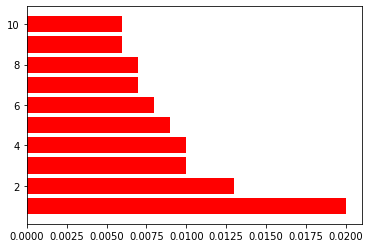

[['0.020*"story" ', ' 0.013*"farmer" ', ' 0.010*"family" ', ' 0.010*"life" ', ' 0.009*"vegetable" ', ' 0.008*"minister" ', ' 0.007*"king" ', ' 0.007*"storytelling" ', ' 0.006*"prime" ', ' 0.006*"cook"'], ['0.009*"story" '], ['0.009*"story" '], ['0.009*"story" '], ['0.009*"story" '], ['0.008*"story" '], ['0.007*"story" '], ['0.007*"story" '], ['0.007*"story" '], ['0.006*"story" ']]
14
[0.026, 0.011, 0.011, 0.01, 0.009, 0.009, 0.009, 0.007, 0.007, 0.007, 0.022, 0.013, 0.01, 0.009, 0.008, 0.008, 0.007, 0.006, 0.005]
[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 1, 1, 1, 1, 1, 1, 1, 1, 1]


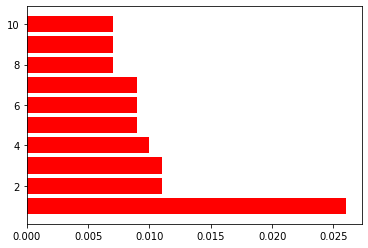

[['0.026*"toy" ', ' 0.011*"friend" ', ' 0.011*"child" ', ' 0.010*"game" ', ' 0.009*"dog" ', ' 0.009*"nutrition" ', ' 0.009*"time" ', ' 0.007*"indian" ', ' 0.007*"student" ', ' 0.007*"teacher"'], ['0.022*"toy" '], ['0.013*"toy" '], ['0.010*"toy" '], ['0.009*"toy" '], ['0.008*"toy" '], ['0.008*"toy" '], ['0.007*"toy" '], ['0.006*"toy" '], ['0.005*"toy" ']]
15
[0.035, 0.026, 0.016, 0.011, 0.011, 0.011, 0.011, 0.01, 0.009, 0.009, 0.02, 0.019, 0.015, 0.013, 0.01, 0.009, 0.008, 0.008, 0.007]
[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 1, 1, 1, 1, 1, 1, 1, 1, 1]


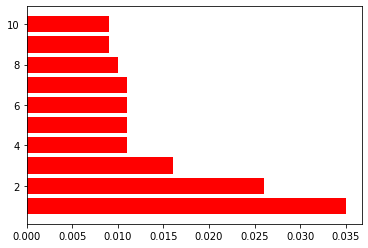

[['0.035*"modi" ', ' 0.026*"sir" ', ' 0.016*"yes" ', ' 0.011*"vinayak" ', ' 0.011*"usman" ', ' 0.011*"kritika" ', ' 0.011*"time" ', ' 0.010*"friend" ', ' 0.009*"people" ', ' 0.009*"kaniga"'], ['0.020*"modi" '], ['0.019*"modi" '], ['0.015*"modi" '], ['0.013*"modi" '], ['0.010*"modi" '], ['0.009*"sir" '], ['0.008*"sir" '], ['0.008*"modi" '], ['0.007*"modi" ']]
16
[0.012, 0.009, 0.009, 0.007, 0.006, 0.006, 0.006, 0.005, 0.005, 0.005, 0.012, 0.006, 0.006, 0.006, 0.005, 0.004, 0.004, 0.004, 0.003]
[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 1, 1, 1, 1, 1, 1, 1, 1, 1]


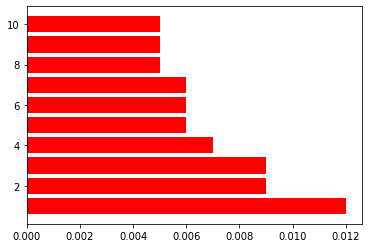

[['0.012*"friend" ', ' 0.009*"game" ', ' 0.009*"time" ', ' 0.007*"people" ', ' 0.006*"life" ', ' 0.006*"village" ', ' 0.006*"sector" ', ' 0.005*"way" ', ' 0.005*"corona" ', ' 0.005*"nature"'], ['0.012*"friend" '], ['0.006*"game" '], ['0.006*"friend" '], ['0.006*"friend" '], ['0.005*"time" '], ['0.004*"game" '], ['0.004*"friend" '], ['0.004*"friend" '], ['0.003*"friend" ']]
17
[0.016, 0.011, 0.011, 0.01, 0.008, 0.008, 0.008, 0.008, 0.007, 0.007, 0.01, 0.01, 0.009, 0.008, 0.008, 0.007, 0.007, 0.007, 0.006]
[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 1, 1, 1, 1, 1, 1, 1, 1, 1]


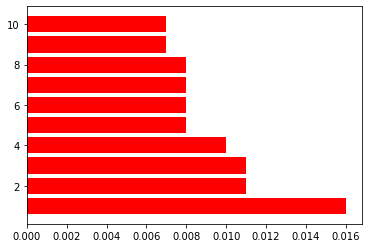

[['0.016*"people" ', ' 0.011*"corona" ', ' 0.011*"life" ', ' 0.010*"yoga" ', ' 0.008*"friend" ', ' 0.008*"ayushman" ', ' 0.008*"scheme" ', ' 0.008*"bharat" ', ' 0.007*"treatment" ', ' 0.007*"time"'], ['0.010*"people" '], ['0.010*"people" '], ['0.009*"people" '], ['0.008*"people" '], ['0.008*"people" '], ['0.007*"people" '], ['0.007*"people" '], ['0.007*"people" '], ['0.006*"corona" ']]
18
[0.015, 0.011, 0.011, 0.009, 0.006, 0.006, 0.006, 0.006, 0.006, 0.005, 0.012, 0.007, 0.006, 0.006, 0.006, 0.006, 0.006, 0.005, 0.005]
[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 1, 1, 1, 1, 1, 1, 1, 1, 1]


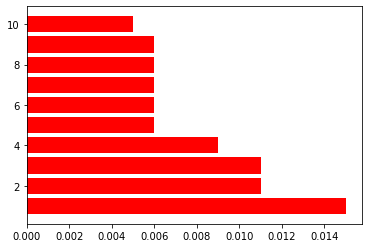

[['0.015*"people" ', ' 0.011*"time" ', ' 0.011*"friend" ', ' 0.009*"corona" ', ' 0.006*"fight" ', ' 0.006*"life" ', ' 0.006*"mask" ', ' 0.006*"government" ', ' 0.006*"personnel" ', ' 0.005*"come"'], ['0.012*"time" '], ['0.007*"people" '], ['0.006*"time" '], ['0.006*"people" '], ['0.006*"people" '], ['0.006*"people" '], ['0.006*"people" '], ['0.005*"time" '], ['0.005*"people" ']]
19
[0.018, 0.012, 0.012, 0.012, 0.011, 0.01, 0.01, 0.009, 0.008, 0.007, 0.016, 0.01, 0.007, 0.007, 0.007, 0.006, 0.006, 0.006, 0.004]
[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 1, 1, 1, 1, 1, 1, 1, 1, 1]


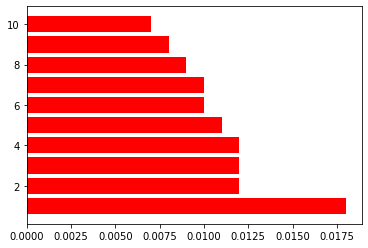

[['0.018*"doctor" ', ' 0.012*"people" ', ' 0.012*"family" ', ' 0.012*"modi" ', ' 0.011*"home" ', ' 0.010*"yes" ', ' 0.010*"sir" ', ' 0.009*"corona" ', ' 0.008*"time" ', ' 0.007*"patient"'], ['0.016*"people" '], ['0.010*"doctor" '], ['0.007*"doctor" '], ['0.007*"doctor" '], ['0.007*"doctor" '], ['0.006*"doctor" '], ['0.006*"doctor" '], ['0.006*"doctor" '], ['0.004*"family" ']]
20
[0.008, 0.007, 0.007, 0.007, 0.007, 0.007, 0.006, 0.006, 0.005, 0.005, 0.005, 0.004, 0.004, 0.004, 0.004, 0.003, 0.003, 0.003, 0.003]
[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 1, 1, 1, 1, 1, 1, 1, 1, 1]


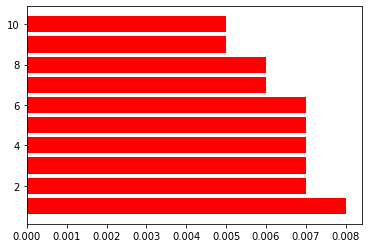

[['0.008*"friend" ', ' 0.007*"indian" ', ' 0.007*"life" ', ' 0.007*"people" ', ' 0.007*"amma" ', ' 0.007*"woman" ', ' 0.006*"bhagirathi" ', ' 0.006*"village" ', ' 0.005*"mission" ', ' 0.005*"kamya"'], ['0.005*"village" '], ['0.004*"woman" '], ['0.004*"village" '], ['0.004*"friend" '], ['0.004*"friend" '], ['0.003*"life" '], ['0.003*"friend" '], ['0.003*"bhagirathi" '], ['0.003*"amma" ']]
21
[0.01, 0.009, 0.008, 0.008, 0.007, 0.007, 0.006, 0.006, 0.005, 0.004, 0.005, 0.005, 0.004, 0.004, 0.004, 0.004, 0.003, 0.003, 0.003]
[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 1, 1, 1, 1, 1, 1, 1, 1, 1]


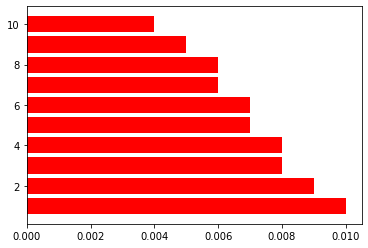

[['0.010*"people" ', ' 0.009*"game" ', ' 0.008*"resolve" ', ' 0.008*"friend" ', ' 0.007*"khelo" ', ' 0.007*"fit" ', ' 0.006*"water" ', ' 0.006*"life" ', ' 0.005*"award" ', ' 0.004*"time"'], ['0.005*"game" '], ['0.005*"game" '], ['0.004*"people" '], ['0.004*"people" '], ['0.004*"people" '], ['0.004*"game" '], ['0.003*"people" '], ['0.003*"game" '], ['0.003*"friend" ']]
22
[0.01, 0.009, 0.008, 0.007, 0.007, 0.006, 0.005, 0.005, 0.005, 0.005, 0.004, 0.004, 0.004, 0.004, 0.004, 0.004, 0.004, 0.004, 0.003]
[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 1, 1, 1, 1, 1, 1, 1, 1, 1]


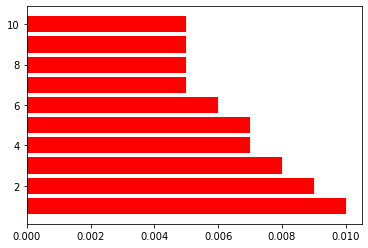

[['0.010*"people" ', ' 0.009*"youth" ', ' 0.008*"eclipse" ', ' 0.007*"programme" ', ' 0.007*"life" ', ' 0.006*"himayat" ', ' 0.005*"solar" ', ' 0.005*"decade" ', ' 0.005*"generation" ', ' 0.005*"come"'], ['0.004*"youth" '], ['0.004*"youth" '], ['0.004*"people" '], ['0.004*"people" '], ['0.004*"people" '], ['0.004*"people" '], ['0.004*"people" '], ['0.004*"people" '], ['0.003*"youth" ']]
23
[0.023, 0.015, 0.014, 0.011, 0.011, 0.01, 0.009, 0.008, 0.008, 0.008, 0.009, 0.009, 0.008, 0.008, 0.008, 0.007, 0.007, 0.006, 0.006]
[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 1, 1, 1, 1, 1, 1, 1, 1, 1]


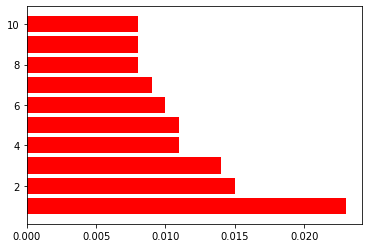

[['0.023*"sir" ', ' 0.015*"prime" ', ' 0.014*"minister" ', ' 0.011*"ncc" ', ' 0.011*"yes" ', ' 0.010*"people" ', ' 0.009*"river" ', ' 0.008*"language" ', ' 0.008*"tarannum" ', ' 0.008*"hari"'], ['0.009*"sir" '], ['0.009*"sir" '], ['0.008*"sir" '], ['0.008*"sir" '], ['0.008*"sir" '], ['0.007*"sir" '], ['0.007*"sir" '], ['0.006*"sir" '], ['0.006*"sir" ']]
24
[0.011, 0.011, 0.008, 0.007, 0.007, 0.007, 0.007, 0.006, 0.006, 0.006, 0.005, 0.005, 0.005, 0.005, 0.005, 0.005, 0.004, 0.004, 0.004]
[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 1, 1, 1, 1, 1, 1, 1, 1, 1]


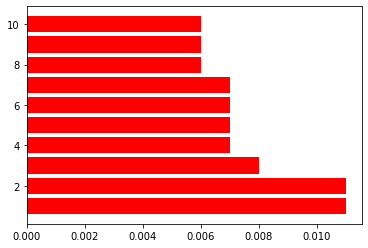

[['0.011*"unity" ', ' 0.011*"people" ', ' 0.008*"sardar" ', ' 0.007*"guru" ', ' 0.007*"diwali" ', ' 0.007*"patel" ', ' 0.007*"dev" ', ' 0.006*"nanak" ', ' 0.006*"indian" ', ' 0.006*"festival"'], ['0.005*"unity" '], ['0.005*"people" '], ['0.005*"people" '], ['0.005*"people" '], ['0.005*"people" '], ['0.005*"people" '], ['0.004*"unity" '], ['0.004*"people" '], ['0.004*"people" ']]
25
[0.011, 0.008, 0.007, 0.007, 0.007, 0.006, 0.006, 0.006, 0.005, 0.005, 0.007, 0.005, 0.004, 0.004, 0.004, 0.004, 0.004, 0.003, 0.003]
[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 1, 1, 1, 1, 1, 1, 1, 1, 1]


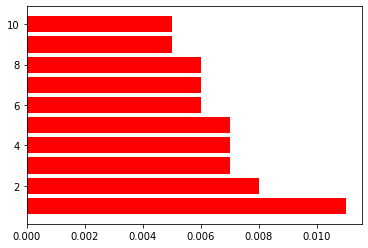

[['0.011*"people" ', ' 0.008*"shall" ', ' 0.007*"time" ', ' 0.007*"young" ', ' 0.007*"festival" ', ' 0.006*"sister" ', ' 0.006*"friend" ', ' 0.006*"come" ', ' 0.005*"way" ', ' 0.005*"know"'], ['0.007*"people" '], ['0.005*"shall" '], ['0.004*"time" '], ['0.004*"people" '], ['0.004*"people" '], ['0.004*"people" '], ['0.004*"people" '], ['0.003*"people" '], ['0.003*"people" ']]
26
[0.012, 0.011, 0.009, 0.009, 0.008, 0.008, 0.007, 0.007, 0.006, 0.006, 0.007, 0.006, 0.006, 0.005, 0.004, 0.004, 0.004, 0.004, 0.004]
[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 1, 1, 1, 1, 1, 1, 1, 1, 1]


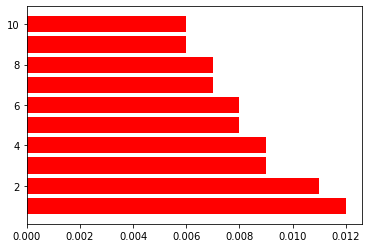

[['0.012*"people" ', ' 0.011*"gandhi" ', ' 0.009*"time" ', ' 0.009*"service" ', ' 0.008*"way" ', ' 0.008*"tiger" ', ' 0.007*"life" ', ' 0.007*"let" ', ' 0.006*"mahatma" ', ' 0.006*"come"'], ['0.007*"people" '], ['0.006*"people" '], ['0.006*"people" '], ['0.005*"people" '], ['0.004*"people" '], ['0.004*"people" '], ['0.004*"gandhi" '], ['0.004*"gandhi" '], ['0.004*"gandhi" ']]
27
[0.01, 0.01, 0.009, 0.007, 0.007, 0.007, 0.006, 0.006, 0.006, 0.006, 0.005, 0.005, 0.005, 0.005, 0.004, 0.004, 0.004, 0.003, 0.003]
[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 1, 1, 1, 1, 1, 1, 1, 1, 1]


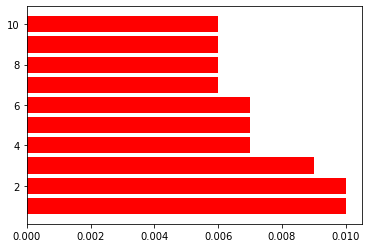

[['0.010*"programme" ', ' 0.010*"people" ', ' 0.009*"village" ', ' 0.007*"month" ', ' 0.007*"water" ', ' 0.007*"book" ', ' 0.006*"time" ', ' 0.006*"friend" ', ' 0.006*"festival" ', ' 0.006*"chandrayaan"'], ['0.005*"village" '], ['0.005*"programme" '], ['0.005*"programme" '], ['0.005*"people" '], ['0.004*"village" '], ['0.004*"village" '], ['0.004*"people" '], ['0.003*"village" '], ['0.003*"programme" ']]
28
[0.021, 0.016, 0.014, 0.007, 0.007, 0.007, 0.006, 0.006, 0.006, 0.005, 0.019, 0.016, 0.01, 0.009, 0.008, 0.008, 0.007, 0.006, 0.006]
[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 1, 1, 1, 1, 1, 1, 1, 1, 1]


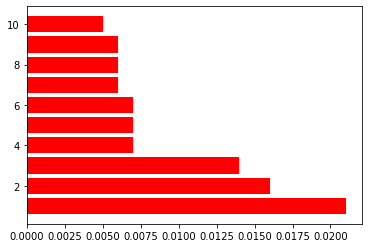

[['0.021*"water" ', ' 0.016*"people" ', ' 0.014*"yoga" ', ' 0.007*"time" ', ' 0.007*"election" ', ' 0.007*"story" ', ' 0.006*"let" ', ' 0.006*"conservation" ', ' 0.006*"democracy" ', ' 0.005*"life"'], ['0.019*"water" '], ['0.016*"water" '], ['0.010*"water" '], ['0.009*"water" '], ['0.008*"water" '], ['0.008*"water" '], ['0.007*"water" '], ['0.006*"water" '], ['0.006*"people" ']]
29
[0.01, 0.01, 0.008, 0.008, 0.007, 0.007, 0.007, 0.006, 0.005, 0.005, 0.006, 0.005, 0.005, 0.004, 0.004, 0.004, 0.003, 0.003, 0.003]
[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 1, 1, 1, 1, 1, 1, 1, 1, 1]


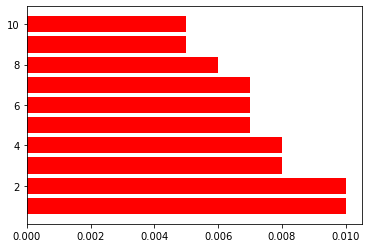

[['0.010*"memorial" ', ' 0.010*"soldier" ', ' 0.008*"people" ', ' 0.008*"life" ', ' 0.007*"national" ', ' 0.007*"family" ', ' 0.007*"martyr" ', ' 0.006*"time" ', ' 0.005*"nation" ', ' 0.005*"sacrifice"'], ['0.006*"memorial" '], ['0.005*"soldier" '], ['0.005*"soldier" '], ['0.004*"soldier" '], ['0.004*"soldier" '], ['0.004*"people" '], ['0.003*"soldier" '], ['0.003*"memorial" '], ['0.003*"life" ']]
30
[0.009, 0.006, 0.006, 0.006, 0.006, 0.005, 0.005, 0.005, 0.005, 0.005, 0.008, 0.007, 0.004, 0.004, 0.003, 0.003, 0.003, 0.003, 0.002]
[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 1, 1, 1, 1, 1, 1, 1, 1, 1]


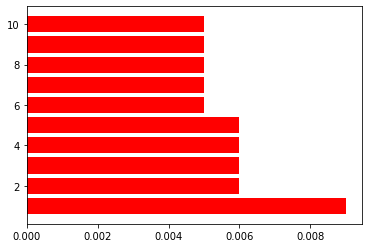

[['0.009*"netaji" ', ' 0.006*"life" ', ' 0.006*"museum" ', ' 0.006*"voter" ', ' 0.006*"young" ', ' 0.005*"subhash" ', ' 0.005*"ravidas" ', ' 0.005*"program" ', ' 0.005*"vote" ', ' 0.005*"commission"'], ['0.008*"space" '], ['0.007*"netaji" '], ['0.004*"netaji" '], ['0.004*"netaji" '], ['0.003*"netaji" '], ['0.003*"netaji" '], ['0.003*"netaji" '], ['0.003*"election" '], ['0.002*"life" ']]
31
[0.014, 0.009, 0.007, 0.007, 0.006, 0.005, 0.004, 0.004, 0.004, 0.004, 0.012, 0.009, 0.009, 0.009, 0.008, 0.008, 0.008, 0.008, 0.007]
[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 1, 1, 1, 1, 1, 1, 1, 1, 1]


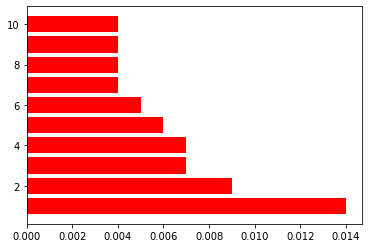

[['0.014*"kumbh" ', ' 0.009*"festival" ', ' 0.007*"life" ', ' 0.007*"people" ', ' 0.006*"society" ', ' 0.005*"great" ', ' 0.004*"rajani" ', ' 0.004*"gobind" ', ' 0.004*"time" ', ' 0.004*"mela"'], ['0.012*"kumbh" '], ['0.009*"kumbh" '], ['0.009*"kumbh" '], ['0.009*"kumbh" '], ['0.008*"kumbh" '], ['0.008*"kumbh" '], ['0.008*"kumbh" '], ['0.008*"kumbh" '], ['0.007*"kumbh" ']]
32
[0.011, 0.011, 0.01, 0.01, 0.009, 0.008, 0.008, 0.007, 0.007, 0.006, 0.006, 0.006, 0.005, 0.005, 0.005, 0.004, 0.004, 0.004, 0.003]
[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 1, 1, 1, 1, 1, 1, 1, 1, 1]


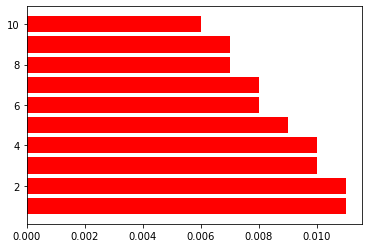

[['0.011*"people" ', ' 0.011*"radio" ', ' 0.010*"medium" ', ' 0.010*"constitution" ', ' 0.009*"episode" ', ' 0.008*"time" ', ' 0.008*"letter" ', ' 0.007*"phone" ', ' 0.007*"youth" ', ' 0.006*"idea"'], ['0.006*"radio" '], ['0.006*"medium" '], ['0.005*"time" '], ['0.005*"people" '], ['0.005*"medium" '], ['0.004*"people" '], ['0.004*"medium" '], ['0.004*"medium" '], ['0.003*"medium" ']]
33
[0.011, 0.007, 0.007, 0.006, 0.006, 0.006, 0.005, 0.005, 0.005, 0.005, 0.008, 0.006, 0.006, 0.004, 0.004, 0.004, 0.004, 0.003, 0.003]
[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 1, 1, 1, 1, 1, 1, 1, 1, 1]


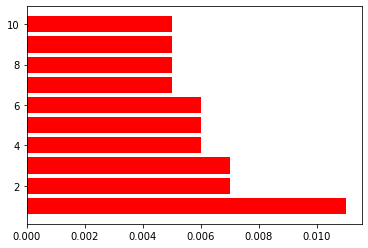

[['0.011*"indian" ', ' 0.007*"patel" ', ' 0.007*"community" ', ' 0.006*"singh" ', ' 0.006*"best" ', ' 0.006*"people" ', ' 0.005*"life" ', ' 0.005*"sardar" ', ' 0.005*"tribal" ', ' 0.005*"sport"'], ['0.008*"indian" '], ['0.006*"indian" '], ['0.006*"indian" '], ['0.004*"patel" '], ['0.004*"indian" '], ['0.004*"indian" '], ['0.004*"indian" '], ['0.003*"indian" '], ['0.003*"indian" ']]
34
[0.014, 0.011, 0.009, 0.009, 0.008, 0.008, 0.008, 0.007, 0.007, 0.007, 0.013, 0.007, 0.005, 0.005, 0.004, 0.004, 0.004, 0.004, 0.004]
[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 1, 1, 1, 1, 1, 1, 1, 1, 1]


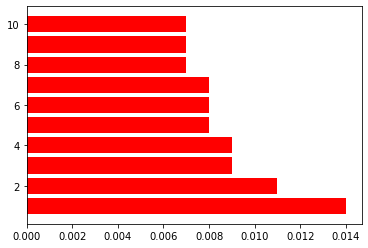

[['0.014*"force" ', ' 0.011*"air" ', ' 0.009*"right" ', ' 0.009*"soldier" ', ' 0.008*"people" ', ' 0.008*"october" ', ' 0.008*"bapu" ', ' 0.007*"birth" ', ' 0.007*"indian" ', ' 0.007*"human"'], ['0.013*"air" '], ['0.007*"force" '], ['0.005*"soldier" '], ['0.005*"air" '], ['0.004*"force" '], ['0.004*"force" '], ['0.004*"force" '], ['0.004*"force" '], ['0.004*"air" ']]
35
[0.01, 0.006, 0.006, 0.006, 0.006, 0.006, 0.005, 0.005, 0.005, 0.005, 0.008, 0.005, 0.004, 0.004, 0.004, 0.004, 0.003, 0.003, 0.003]
[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 1, 1, 1, 1, 1, 1, 1, 1, 1]


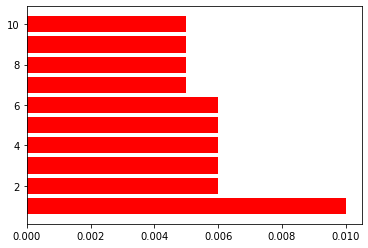

[['0.010*"atalji" ', ' 0.006*"people" ', ' 0.006*"life" ', ' 0.006*"kerala" ', ' 0.006*"time" ', ' 0.006*"indian" ', ' 0.005*"sabha" ', ' 0.005*"engineer" ', ' 0.005*"sanskrit" ', ' 0.005*"medal"'], ['0.008*"atalji" '], ['0.005*"atalji" '], ['0.004*"atalji" '], ['0.004*"atalji" '], ['0.004*"atalji" '], ['0.004*"atalji" '], ['0.003*"atalji" '], ['0.003*"atalji" '], ['0.003*"atalji" ']]
36
[0.01, 0.008, 0.008, 0.007, 0.006, 0.006, 0.005, 0.005, 0.005, 0.005, 0.005, 0.005, 0.005, 0.004, 0.004, 0.003, 0.003, 0.003, 0.003]
[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 1, 1, 1, 1, 1, 1, 1, 1, 1]


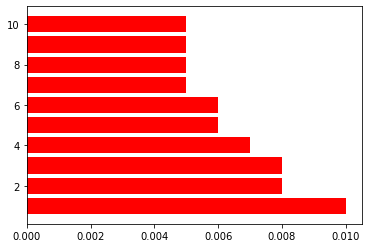

[['0.010*"life" ', ' 0.008*"people" ', ' 0.008*"time" ', ' 0.007*"village" ', ' 0.006*"tilak" ', ' 0.006*"lok" ', ' 0.005*"manya" ', ' 0.005*"youth" ', ' 0.005*"app" ', ' 0.005*"statue"'], ['0.005*"people" '], ['0.005*"people" '], ['0.005*"life" '], ['0.004*"people" '], ['0.004*"life" '], ['0.003*"time" '], ['0.003*"life" '], ['0.003*"life" '], ['0.003*"life" ']]
37
[0.018, 0.007, 0.007, 0.007, 0.006, 0.006, 0.006, 0.006, 0.005, 0.005, 0.017, 0.009, 0.009, 0.008, 0.007, 0.006, 0.006, 0.005, 0.003]
[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 1, 1, 1, 1, 1, 1, 1, 1, 1]


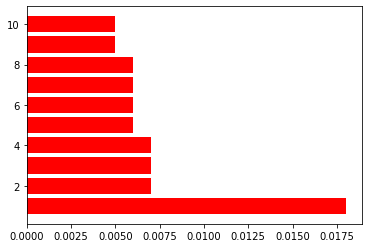

[['0.018*"people" ', ' 0.007*"yoga" ', ' 0.007*"time" ', ' 0.007*"doctor" ', ' 0.006*"life" ', ' 0.006*"mukherjee" ', ' 0.006*"farmer" ', ' 0.006*"gst" ', ' 0.005*"prasad" ', ' 0.005*"know"'], ['0.017*"people" '], ['0.009*"people" '], ['0.009*"people" '], ['0.008*"people" '], ['0.007*"people" '], ['0.006*"people" '], ['0.006*"people" '], ['0.005*"people" '], ['0.003*"people" ']]
38
[0.02, 0.01, 0.009, 0.008, 0.007, 0.007, 0.007, 0.006, 0.006, 0.006, 0.009, 0.009, 0.008, 0.008, 0.006, 0.006, 0.005, 0.005, 0.004]
[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 1, 1, 1, 1, 1, 1, 1, 1, 1]


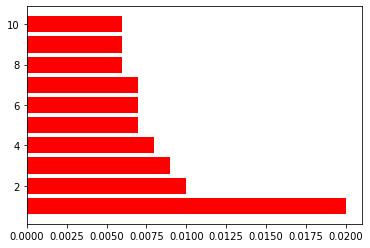

[['0.020*"game" ', ' 0.010*"savarkar" ', ' 0.009*"child" ', ' 0.008*"life" ', ' 0.007*"daughter" ', ' 0.007*"month" ', ' 0.007*"people" ', ' 0.006*"everest" ', ' 0.006*"sport" ', ' 0.006*"mean"'], ['0.009*"game" '], ['0.009*"game" '], ['0.008*"game" '], ['0.008*"game" '], ['0.006*"game" '], ['0.006*"game" '], ['0.005*"game" '], ['0.005*"game" '], ['0.004*"game" ']]
39
[0.016, 0.012, 0.011, 0.008, 0.005, 0.005, 0.005, 0.005, 0.005, 0.004, 0.013, 0.007, 0.006, 0.006, 0.006, 0.006, 0.005, 0.005, 0.004]
[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 1, 1, 1, 1, 1, 1, 1, 1, 1]


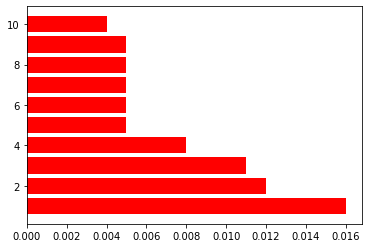

[['0.016*"water" ', ' 0.012*"people" ', ' 0.011*"buddha" ', ' 0.008*"lord" ', ' 0.005*"medal" ', ' 0.005*"conservation" ', ' 0.005*"way" ', ' 0.005*"performance" ', ' 0.005*"time" ', ' 0.004*"know"'], ['0.013*"buddha" '], ['0.007*"water" '], ['0.006*"water" '], ['0.006*"water" '], ['0.006*"water" '], ['0.006*"water" '], ['0.005*"buddha" '], ['0.005*"buddha" '], ['0.004*"water" ']]
40
[0.012, 0.009, 0.007, 0.006, 0.006, 0.005, 0.005, 0.005, 0.005, 0.005, 0.011, 0.009, 0.006, 0.005, 0.005, 0.004, 0.004, 0.003, 0.003]
[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 1, 1, 1, 1, 1, 1, 1, 1, 1]


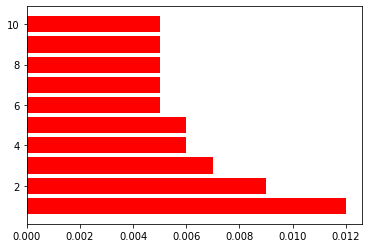

[['0.012*"farmer" ', ' 0.009*"yoga" ', ' 0.007*"cost" ', ' 0.006*"health" ', ' 0.006*"letter" ', ' 0.005*"effort" ', ' 0.005*"way" ', ' 0.005*"water" ', ' 0.005*"time" ', ' 0.005*"family"'], ['0.011*"health" '], ['0.009*"yoga" '], ['0.006*"farmer" '], ['0.005*"farmer" '], ['0.005*"farmer" '], ['0.004*"yoga" '], ['0.004*"farmer" '], ['0.003*"farmer" '], ['0.003*"farmer" ']]
41
[0.017, 0.015, 0.011, 0.011, 0.009, 0.009, 0.006, 0.005, 0.005, 0.005, 0.008, 0.008, 0.007, 0.007, 0.006, 0.005, 0.005, 0.005, 0.005]
[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 1, 1, 1, 1, 1, 1, 1, 1, 1]


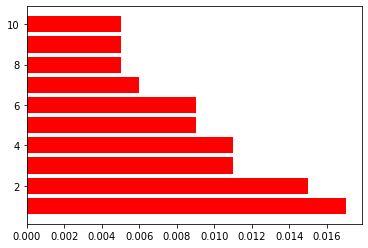

[['0.017*"life" ', ' 0.015*"safety" ', ' 0.011*"festival" ', ' 0.011*"woman" ', ' 0.009*"disaster" ', ' 0.009*"waste" ', ' 0.006*"science" ', ' 0.005*"intelligence" ', ' 0.005*"people" ', ' 0.005*"thousand"'], ['0.008*"safety" '], ['0.008*"life" '], ['0.007*"life" '], ['0.007*"life" '], ['0.006*"life" '], ['0.005*"safety" '], ['0.005*"safety" '], ['0.005*"life" '], ['0.005*"life" ']]
42
[0.028, 0.013, 0.011, 0.007, 0.006, 0.006, 0.006, 0.006, 0.006, 0.005, 0.015, 0.012, 0.01, 0.01, 0.009, 0.008, 0.008, 0.008, 0.007]
[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 1, 1, 1, 1, 1, 1, 1, 1, 1]


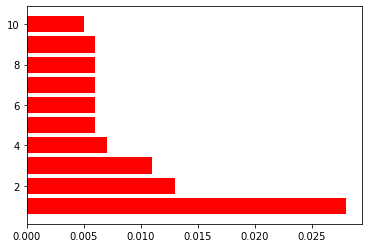

[['0.028*"woman" ', ' 0.013*"people" ', ' 0.011*"society" ', ' 0.007*"medicine" ', ' 0.006*"social" ', ' 0.006*"life" ', ' 0.006*"time" ', ' 0.006*"award" ', ' 0.006*"indian" ', ' 0.005*"morna"'], ['0.015*"woman" '], ['0.012*"woman" '], ['0.010*"woman" '], ['0.010*"woman" '], ['0.009*"woman" '], ['0.008*"woman" '], ['0.008*"woman" '], ['0.008*"woman" '], ['0.007*"woman" ']]
43
[0.011, 0.008, 0.008, 0.008, 0.007, 0.007, 0.007, 0.007, 0.007, 0.007, 0.006, 0.006, 0.005, 0.005, 0.004, 0.004, 0.004, 0.004, 0.003]
[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 1, 1, 1, 1, 1, 1, 1, 1, 1]


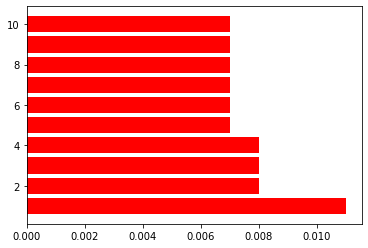

[['0.011*"cleanliness" ', ' 0.008*"life" ', ' 0.008*"city" ', ' 0.008*"people" ', ' 0.007*"youth" ', ' 0.007*"festival" ', ' 0.007*"woman" ', ' 0.007*"january" ', ' 0.007*"service" ', ' 0.007*"let"'], ['0.006*"life" '], ['0.006*"cleanliness" '], ['0.005*"cleanliness" '], ['0.005*"cleanliness" '], ['0.004*"service" '], ['0.004*"people" '], ['0.004*"cleanliness" '], ['0.004*"cleanliness" '], ['0.003*"cleanliness" ']]
44
[0.011, 0.009, 0.009, 0.009, 0.007, 0.007, 0.007, 0.006, 0.006, 0.006, 0.006, 0.005, 0.005, 0.005, 0.005, 0.005, 0.004, 0.004, 0.004]
[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 1, 1, 1, 1, 1, 1, 1, 1, 1]


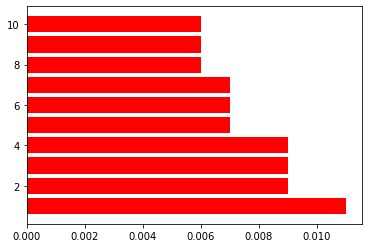

[['0.011*"people" ', ' 0.009*"khadi" ', ' 0.009*"life" ', ' 0.009*"indian" ', ' 0.007*"nivedita" ', ' 0.007*"force" ', ' 0.007*"security" ', ' 0.006*"woman" ', ' 0.006*"know" ', ' 0.006*"child"'], ['0.006*"people" '], ['0.005*"people" '], ['0.005*"people" '], ['0.005*"people" '], ['0.005*"people" '], ['0.005*"life" '], ['0.004*"people" '], ['0.004*"people" '], ['0.004*"people" ']]
45
[0.018, 0.011, 0.009, 0.007, 0.007, 0.006, 0.006, 0.005, 0.005, 0.005, 0.015, 0.009, 0.008, 0.007, 0.006, 0.006, 0.006, 0.006, 0.004]
[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 1, 1, 1, 1, 1, 1, 1, 1, 1]


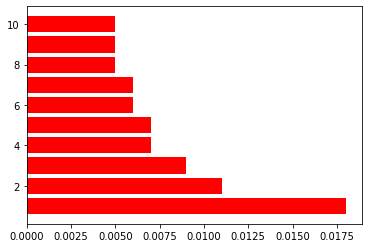

[['0.018*"people" ', ' 0.011*"khadi" ', ' 0.009*"cleanliness" ', ' 0.007*"got" ', ' 0.007*"life" ', ' 0.006*"diversity" ', ' 0.006*"campaign" ', ' 0.005*"time" ', ' 0.005*"great" ', ' 0.005*"thing"'], ['0.015*"people" '], ['0.009*"people" '], ['0.008*"people" '], ['0.007*"people" '], ['0.006*"people" '], ['0.006*"people" '], ['0.006*"people" '], ['0.006*"people" '], ['0.004*"people" ']]
46
[0.014, 0.011, 0.01, 0.008, 0.008, 0.007, 0.007, 0.007, 0.007, 0.007, 0.008, 0.007, 0.007, 0.006, 0.006, 0.005, 0.005, 0.004, 0.004]
[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 1, 1, 1, 1, 1, 1, 1, 1, 1]


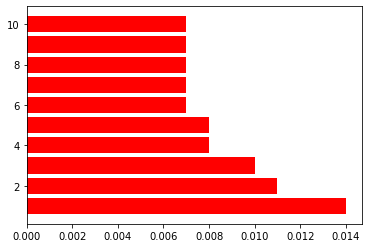

[['0.014*"festival" ', ' 0.011*"come" ', ' 0.010*"cleanliness" ', ' 0.008*"sport" ', ' 0.008*"people" ', ' 0.007*"rupee" ', ' 0.007*"teacher" ', ' 0.007*"life" ', ' 0.007*"pradhan" ', ' 0.007*"mantri"'], ['0.008*"festival" '], ['0.007*"festival" '], ['0.007*"festival" '], ['0.006*"festival" '], ['0.006*"festival" '], ['0.005*"festival" '], ['0.005*"festival" '], ['0.004*"festival" '], ['0.004*"come" ']]
47
[0.014, 0.013, 0.012, 0.011, 0.009, 0.009, 0.009, 0.009, 0.008, 0.008, 0.013, 0.007, 0.007, 0.006, 0.006, 0.006, 0.005, 0.005, 0.004]
[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 1, 1, 1, 1, 1, 1, 1, 1, 1]


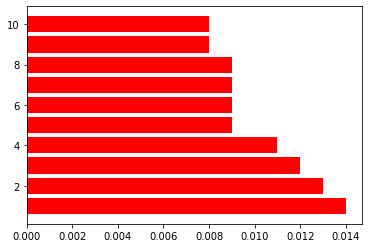

[['0.014*"people" ', ' 0.013*"resolve" ', ' 0.012*"time" ', ' 0.011*"festival" ', ' 0.009*"freedom" ', ' 0.009*"august" ', ' 0.009*"movement" ', ' 0.009*"quit" ', ' 0.008*"come" ', ' 0.008*"government"'], ['0.013*"time" '], ['0.007*"people" '], ['0.007*"people" '], ['0.006*"resolve" '], ['0.006*"people" '], ['0.006*"people" '], ['0.005*"resolve" '], ['0.005*"people" '], ['0.004*"august" ']]
48
[0.017, 0.012, 0.01, 0.007, 0.007, 0.006, 0.006, 0.006, 0.006, 0.006, 0.01, 0.009, 0.007, 0.007, 0.007, 0.006, 0.006, 0.006, 0.004]
[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 1, 1, 1, 1, 1, 1, 1, 1, 1]


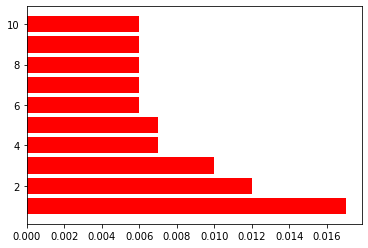

[['0.017*"yoga" ', ' 0.012*"government" ', ' 0.010*"people" ', ' 0.007*"opportunity" ', ' 0.007*"democracy" ', ' 0.006*"month" ', ' 0.006*"habit" ', ' 0.006*"good" ', ' 0.006*"life" ', ' 0.006*"sport"'], ['0.010*"yoga" '], ['0.009*"yoga" '], ['0.007*"yoga" '], ['0.007*"yoga" '], ['0.007*"yoga" '], ['0.006*"yoga" '], ['0.006*"yoga" '], ['0.006*"yoga" '], ['0.004*"yoga" ']]
49
[0.016, 0.015, 0.012, 0.01, 0.008, 0.007, 0.006, 0.006, 0.006, 0.005, 0.009, 0.008, 0.008, 0.007, 0.007, 0.006, 0.005, 0.005, 0.004]
[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 1, 1, 1, 1, 1, 1, 1, 1, 1]


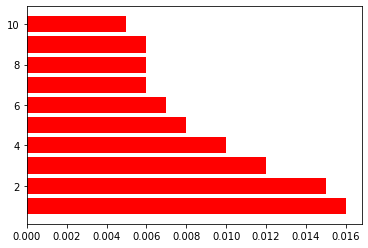

[['0.016*"people" ', ' 0.015*"waste" ', ' 0.012*"yoga" ', ' 0.010*"cleanliness" ', ' 0.008*"campaign" ', ' 0.007*"time" ', ' 0.006*"nature" ', ' 0.006*"movement" ', ' 0.006*"freedom" ', ' 0.005*"bin"'], ['0.009*"people" '], ['0.008*"people" '], ['0.008*"people" '], ['0.007*"waste" '], ['0.007*"people" '], ['0.006*"waste" '], ['0.005*"yoga" '], ['0.005*"people" '], ['0.004*"people" ']]
50
[0.012, 0.012, 0.011, 0.01, 0.009, 0.009, 0.008, 0.006, 0.005, 0.005, 0.007, 0.007, 0.006, 0.005, 0.005, 0.005, 0.005, 0.004, 0.003]
[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 1, 1, 1, 1, 1, 1, 1, 1, 1]


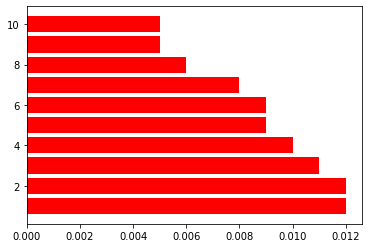

[['0.012*"people" ', ' 0.012*"experience" ', ' 0.011*"time" ', ' 0.010*"try" ', ' 0.009*"learn" ', ' 0.009*"life" ', ' 0.008*"suggestion" ', ' 0.006*"come" ', ' 0.005*"government" ', ' 0.005*"opportunity"'], ['0.007*"people" '], ['0.007*"experience" '], ['0.006*"people" '], ['0.005*"people" '], ['0.005*"people" '], ['0.005*"people" '], ['0.005*"experience" '], ['0.004*"people" '], ['0.003*"people" ']]
51
[0.012, 0.01, 0.009, 0.008, 0.007, 0.007, 0.006, 0.006, 0.006, 0.006, 0.006, 0.006, 0.005, 0.005, 0.005, 0.005, 0.004, 0.004, 0.004]
[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 1, 1, 1, 1, 1, 1, 1, 1, 1]


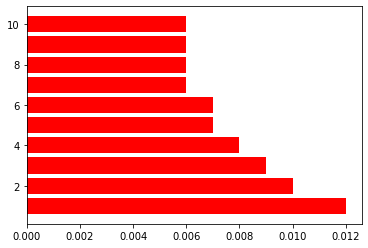

[['0.012*"people" ', ' 0.010*"gandhi" ', ' 0.009*"crore" ', ' 0.008*"family" ', ' 0.007*"resolve" ', ' 0.007*"depression" ', ' 0.006*"satyagraha" ', ' 0.006*"champaran" ', ' 0.006*"time" ', ' 0.006*"bhagat"'], ['0.006*"people" '], ['0.006*"people" '], ['0.005*"people" '], ['0.005*"people" '], ['0.005*"people" '], ['0.005*"people" '], ['0.004*"people" '], ['0.004*"people" '], ['0.004*"people" ']]
52
[0.009, 0.007, 0.007, 0.006, 0.006, 0.005, 0.005, 0.005, 0.005, 0.005, 0.008, 0.004, 0.004, 0.004, 0.004, 0.004, 0.004, 0.003, 0.003]
[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 1, 1, 1, 1, 1, 1, 1, 1, 1]


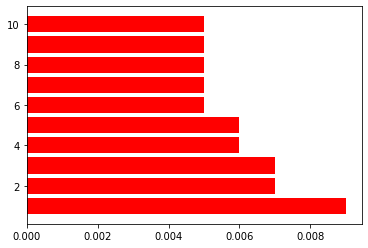

[['0.009*"people" ', ' 0.007*"time" ', ' 0.007*"farmer" ', ' 0.006*"scientist" ', ' 0.006*"way" ', ' 0.005*"woman" ', ' 0.005*"thousand" ', ' 0.005*"prize" ', ' 0.005*"science" ', ' 0.005*"pit"'], ['0.008*"farmer" '], ['0.004*"way" '], ['0.004*"people" '], ['0.004*"farmer" '], ['0.004*"farmer" '], ['0.004*"farmer" '], ['0.004*"farmer" '], ['0.003*"scientist" '], ['0.003*"farmer" ']]
53
[0.016, 0.014, 0.01, 0.007, 0.006, 0.006, 0.006, 0.006, 0.005, 0.005, 0.01, 0.008, 0.006, 0.006, 0.006, 0.005, 0.005, 0.005, 0.004]
[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 1, 1, 1, 1, 1, 1, 1, 1, 1]


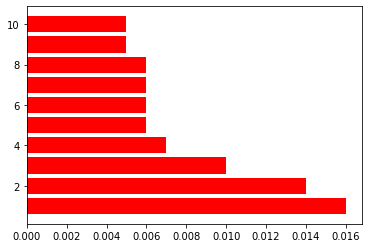

[['0.016*"exam" ', ' 0.014*"life" ', ' 0.010*"time" ', ' 0.007*"question" ', ' 0.006*"thing" ', ' 0.006*"mark" ', ' 0.006*"mean" ', ' 0.006*"family" ', ' 0.005*"come" ', ' 0.005*"examination"'], ['0.010*"time" '], ['0.008*"time" '], ['0.006*"life" '], ['0.006*"exam" '], ['0.006*"exam" '], ['0.005*"exam" '], ['0.005*"exam" '], ['0.005*"exam" '], ['0.004*"exam" ']]
54
[0.018, 0.013, 0.008, 0.007, 0.007, 0.006, 0.006, 0.006, 0.006, 0.006, 0.018, 0.009, 0.007, 0.007, 0.007, 0.006, 0.006, 0.006, 0.006]
[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 1, 1, 1, 1, 1, 1, 1, 1, 1]


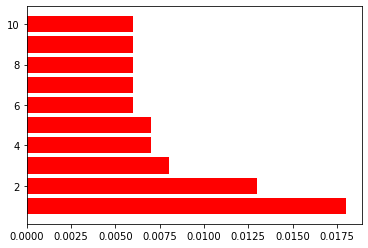

[['0.018*"people" ', ' 0.013*"government" ', ' 0.008*"rupee" ', ' 0.007*"thousand" ', ' 0.007*"reward" ', ' 0.006*"money" ', ' 0.006*"scheme" ', ' 0.006*"corruption" ', ' 0.006*"poor" ', ' 0.006*"digital"'], ['0.018*"people" '], ['0.009*"people" '], ['0.007*"people" '], ['0.007*"people" '], ['0.007*"people" '], ['0.006*"people" '], ['0.006*"people" '], ['0.006*"people" '], ['0.006*"people" ']]
55
[0.016, 0.008, 0.008, 0.007, 0.006, 0.005, 0.005, 0.005, 0.005, 0.005, 0.013, 0.013, 0.01, 0.008, 0.006, 0.006, 0.005, 0.004, 0.004]
[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 1, 1, 1, 1, 1, 1, 1, 1, 1]


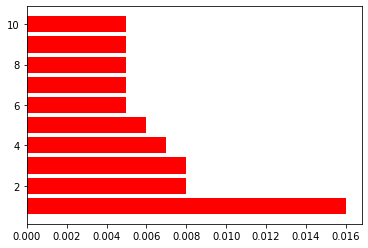

[['0.016*"people" ', ' 0.008*"money" ', ' 0.008*"bank" ', ' 0.007*"know" ', ' 0.006*"crore" ', ' 0.005*"small" ', ' 0.005*"nation" ', ' 0.005*"rupee" ', ' 0.005*"come" ', ' 0.005*"village"'], ['0.013*"people" '], ['0.013*"people" '], ['0.010*"people" '], ['0.008*"people" '], ['0.006*"people" '], ['0.006*"people" '], ['0.005*"people" '], ['0.004*"people" '], ['0.004*"people" ']]
56
[0.011, 0.009, 0.009, 0.009, 0.008, 0.008, 0.006, 0.006, 0.006, 0.006, 0.006, 0.006, 0.005, 0.005, 0.005, 0.004, 0.004, 0.004, 0.004]
[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 1, 1, 1, 1, 1, 1, 1, 1, 1]


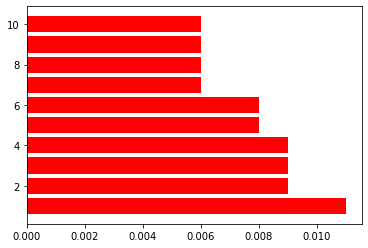

[['0.011*"festival" ', ' 0.009*"great" ', ' 0.009*"deepawali" ', ' 0.009*"sardar" ', ' 0.008*"diwali" ', ' 0.008*"village" ', ' 0.006*"free" ', ' 0.006*"message" ', ' 0.006*"people" ', ' 0.006*"time"'], ['0.006*"festival" '], ['0.006*"festival" '], ['0.005*"sardar" '], ['0.005*"festival" '], ['0.005*"festival" '], ['0.004*"sardar" '], ['0.004*"festival" '], ['0.004*"festival" '], ['0.004*"deepawali" ']]
57
[0.013, 0.008, 0.008, 0.008, 0.007, 0.007, 0.006, 0.006, 0.005, 0.005, 0.01, 0.007, 0.006, 0.006, 0.005, 0.005, 0.004, 0.004, 0.004]
[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 1, 1, 1, 1, 1, 1, 1, 1, 1]


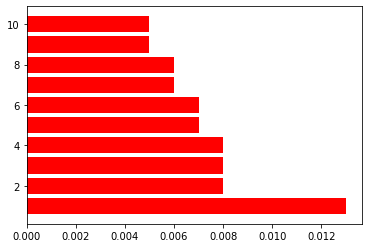

[['0.013*"cleanliness" ', ' 0.008*"people" ', ' 0.008*"october" ', ' 0.008*"time" ', ' 0.007*"government" ', ' 0.007*"medal" ', ' 0.006*"divyang" ', ' 0.006*"athlete" ', ' 0.005*"citizen" ', ' 0.005*"gold"'], ['0.010*"cleanliness" '], ['0.007*"cleanliness" '], ['0.006*"cleanliness" '], ['0.006*"cleanliness" '], ['0.005*"government" '], ['0.005*"cleanliness" '], ['0.004*"cleanliness" '], ['0.004*"cleanliness" '], ['0.004*"cleanliness" ']]
58
[0.014, 0.014, 0.008, 0.008, 0.008, 0.008, 0.007, 0.007, 0.007, 0.006, 0.009, 0.008, 0.007, 0.007, 0.006, 0.005, 0.005, 0.004, 0.004]
[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 1, 1, 1, 1, 1, 1, 1, 1, 1]


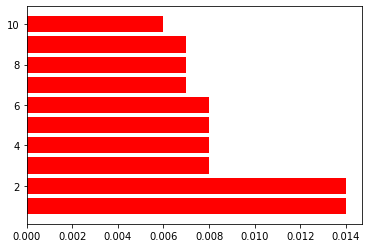

[['0.014*"people" ', ' 0.014*"teacher" ', ' 0.008*"time" ', ' 0.008*"ganesh" ', ' 0.008*"government" ', ' 0.008*"letter" ', ' 0.007*"good" ', ' 0.007*"life" ', ' 0.007*"student" ', ' 0.006*"mother"'], ['0.009*"people" '], ['0.008*"teacher" '], ['0.007*"teacher" '], ['0.007*"teacher" '], ['0.006*"people" '], ['0.005*"teacher" '], ['0.005*"people" '], ['0.004*"people" '], ['0.004*"people" ']]
59
[0.009, 0.009, 0.009, 0.007, 0.007, 0.006, 0.006, 0.005, 0.005, 0.005, 0.005, 0.005, 0.004, 0.004, 0.004, 0.004, 0.004, 0.003, 0.003]
[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 1, 1, 1, 1, 1, 1, 1, 1, 1]


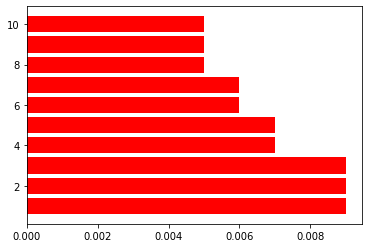

[['0.009*"government" ', ' 0.009*"tree" ', ' 0.009*"time" ', ' 0.007*"technology" ', ' 0.007*"life" ', ' 0.006*"let" ', ' 0.006*"people" ', ' 0.005*"innovation" ', ' 0.005*"rio" ', ' 0.005*"come"'], ['0.005*"tree" '], ['0.005*"government" '], ['0.004*"tree" '], ['0.004*"time" '], ['0.004*"time" '], ['0.004*"government" '], ['0.004*"government" '], ['0.003*"tree" '], ['0.003*"tree" ']]
60
[0.028, 0.016, 0.01, 0.009, 0.008, 0.008, 0.007, 0.006, 0.006, 0.005, 0.024, 0.013, 0.012, 0.01, 0.01, 0.01, 0.008, 0.005, 0.005]
[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 1, 1, 1, 1, 1, 1, 1, 1, 1]


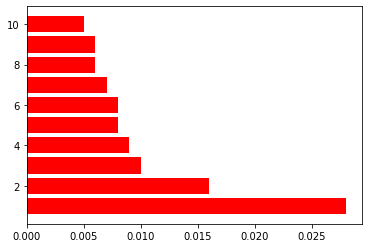

[['0.028*"people" ', ' 0.016*"yoga" ', ' 0.010*"time" ', ' 0.009*"government" ', ' 0.008*"want" ', ' 0.008*"democracy" ', ' 0.007*"lot" ', ' 0.006*"june" ', ' 0.006*"income" ', ' 0.005*"satellite"'], ['0.024*"people" '], ['0.013*"people" '], ['0.012*"people" '], ['0.010*"people" '], ['0.010*"people" '], ['0.010*"people" '], ['0.008*"people" '], ['0.005*"people" '], ['0.005*"people" ']]
61
[0.024, 0.009, 0.007, 0.006, 0.006, 0.006, 0.005, 0.005, 0.005, 0.005, 0.019, 0.017, 0.017, 0.016, 0.015, 0.013, 0.013, 0.013, 0.012]
[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 1, 1, 1, 1, 1, 1, 1, 1, 1]


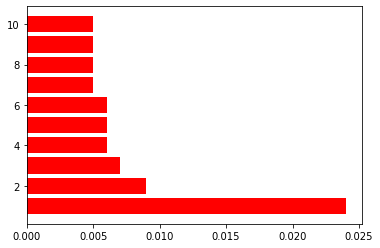

[['0.024*"water" ', ' 0.009*"people" ', ' 0.007*"state" ', ' 0.006*"life" ', ' 0.006*"time" ', ' 0.006*"sport" ', ' 0.005*"result" ', ' 0.005*"pradesh" ', ' 0.005*"yog" ', ' 0.005*"work"'], ['0.019*"water" '], ['0.017*"water" '], ['0.017*"water" '], ['0.016*"water" '], ['0.015*"water" '], ['0.013*"water" '], ['0.013*"water" '], ['0.013*"water" '], ['0.012*"water" ']]
62
[0.021, 0.016, 0.013, 0.011, 0.011, 0.01, 0.009, 0.009, 0.007, 0.006, 0.018, 0.015, 0.014, 0.008, 0.008, 0.007, 0.007, 0.007, 0.006]
[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 1, 1, 1, 1, 1, 1, 1, 1, 1]


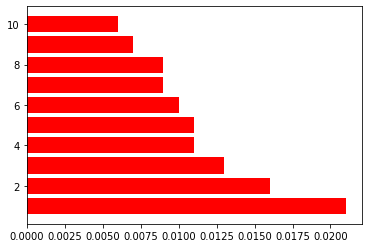

[['0.021*"water" ', ' 0.016*"people" ', ' 0.013*"good" ', ' 0.011*"education" ', ' 0.011*"village" ', ' 0.010*"government" ', ' 0.009*"news" ', ' 0.009*"ganga" ', ' 0.007*"time" ', ' 0.006*"crore"'], ['0.018*"water" '], ['0.015*"people" '], ['0.014*"water" '], ['0.008*"water" '], ['0.008*"water" '], ['0.007*"water" '], ['0.007*"water" '], ['0.007*"people" '], ['0.006*"water" ']]
63
[0.015, 0.009, 0.009, 0.008, 0.007, 0.007, 0.007, 0.007, 0.007, 0.007, 0.01, 0.007, 0.007, 0.006, 0.006, 0.005, 0.004, 0.004, 0.003]
[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 1, 1, 1, 1, 1, 1, 1, 1, 1]


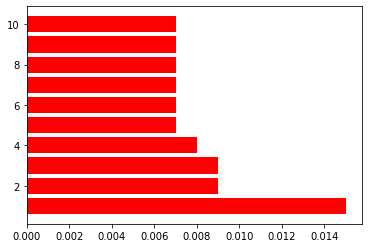

[['0.015*"water" ', ' 0.009*"place" ', ' 0.009*"time" ', ' 0.008*"people" ', ' 0.007*"citizen" ', ' 0.007*"friend" ', ' 0.007*"fifa" ', ' 0.007*"lot" ', ' 0.007*"youth" ', ' 0.007*"holiday"'], ['0.010*"water" '], ['0.007*"water" '], ['0.007*"water" '], ['0.006*"water" '], ['0.006*"water" '], ['0.005*"water" '], ['0.004*"water" '], ['0.004*"water" '], ['0.003*"water" ']]
64
[0.024, 0.015, 0.014, 0.013, 0.01, 0.01, 0.009, 0.009, 0.008, 0.008, 0.014, 0.013, 0.013, 0.011, 0.011, 0.01, 0.008, 0.006, 0.006]
[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 1, 1, 1, 1, 1, 1, 1, 1, 1]


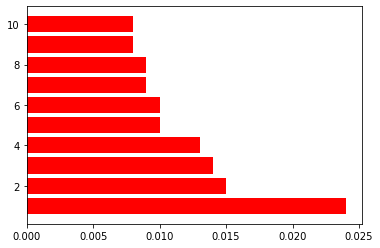

[['0.024*"exam" ', ' 0.015*"time" ', ' 0.014*"thing" ', ' 0.013*"friend" ', ' 0.010*"student" ', ' 0.010*"mind" ', ' 0.009*"science" ', ' 0.009*"question" ', ' 0.008*"going" ', ' 0.008*"sleep"'], ['0.014*"exam" '], ['0.013*"exam" '], ['0.013*"exam" '], ['0.011*"exam" '], ['0.011*"exam" '], ['0.010*"exam" '], ['0.008*"exam" '], ['0.006*"exam" '], ['0.006*"exam" ']]
65
[0.019, 0.017, 0.01, 0.009, 0.008, 0.007, 0.006, 0.006, 0.005, 0.005, 0.01, 0.01, 0.01, 0.009, 0.007, 0.006, 0.005, 0.005, 0.004]
[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 1, 1, 1, 1, 1, 1, 1, 1, 1]


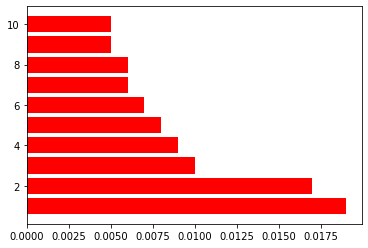

[['0.019*"people" ', ' 0.017*"khadi" ', ' 0.010*"farmer" ', ' 0.009*"startup" ', ' 0.008*"good" ', ' 0.007*"send" ', ' 0.006*"effort" ', ' 0.006*"station" ', ' 0.005*"government" ', ' 0.005*"want"'], ['0.010*"people" '], ['0.010*"people" '], ['0.010*"people" '], ['0.009*"people" '], ['0.007*"khadi" '], ['0.006*"people" '], ['0.005*"people" '], ['0.005*"people" '], ['0.004*"people" ']]
66
[0.021, 0.013, 0.011, 0.009, 0.008, 0.008, 0.008, 0.007, 0.007, 0.007, 0.01, 0.009, 0.009, 0.008, 0.007, 0.007, 0.007, 0.006, 0.006]
[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 1, 1, 1, 1, 1, 1, 1, 1, 1]


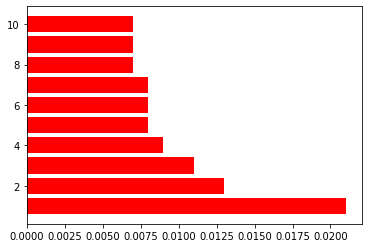

[['0.021*"people" ', ' 0.013*"government" ', ' 0.011*"scheme" ', ' 0.009*"indian" ', ' 0.008*"village" ', ' 0.008*"january" ', ' 0.008*"lot" ', ' 0.007*"nation" ', ' 0.007*"thing" ', ' 0.007*"startup"'], ['0.010*"people" '], ['0.009*"people" '], ['0.009*"people" '], ['0.008*"people" '], ['0.007*"people" '], ['0.007*"people" '], ['0.007*"people" '], ['0.006*"people" '], ['0.006*"people" ']]
67
[0.015, 0.01, 0.009, 0.009, 0.008, 0.007, 0.006, 0.006, 0.006, 0.006, 0.01, 0.01, 0.009, 0.007, 0.006, 0.005, 0.005, 0.004, 0.004]
[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 1, 1, 1, 1, 1, 1, 1, 1, 1]


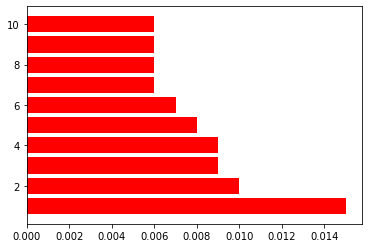

[['0.015*"people" ', ' 0.010*"work" ', ' 0.009*"life" ', ' 0.009*"good" ', ' 0.008*"government" ', ' 0.007*"stump" ', ' 0.006*"mudra" ', ' 0.006*"organ" ', ' 0.006*"time" ', ' 0.006*"crop"'], ['0.010*"people" '], ['0.010*"people" '], ['0.009*"people" '], ['0.007*"people" '], ['0.006*"people" '], ['0.005*"work" '], ['0.005*"people" '], ['0.004*"stump" '], ['0.004*"people" ']]
68
[0.017, 0.011, 0.008, 0.007, 0.007, 0.007, 0.007, 0.007, 0.007, 0.007, 0.016, 0.008, 0.008, 0.007, 0.007, 0.007, 0.007, 0.007, 0.004]
[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 1, 1, 1, 1, 1, 1, 1, 1, 1]


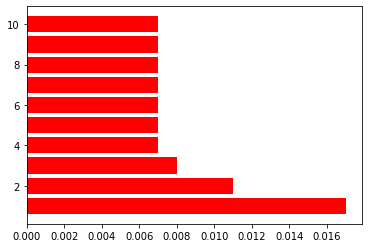

[['0.017*"gold" ', ' 0.011*"people" ', ' 0.008*"village" ', ' 0.007*"place" ', ' 0.007*"government" ', ' 0.007*"organ" ', ' 0.007*"time" ', ' 0.007*"diwali" ', ' 0.007*"donation" ', ' 0.007*"clean"'], ['0.016*"gold" '], ['0.008*"gold" '], ['0.008*"gold" '], ['0.007*"people" '], ['0.007*"gold" '], ['0.007*"gold" '], ['0.007*"gold" '], ['0.007*"gold" '], ['0.004*"gold" ']]
69
[0.017, 0.011, 0.01, 0.009, 0.009, 0.008, 0.008, 0.007, 0.007, 0.007, 0.011, 0.009, 0.008, 0.007, 0.007, 0.006, 0.006, 0.006, 0.006]
[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 1, 1, 1, 1, 1, 1, 1, 1, 1]


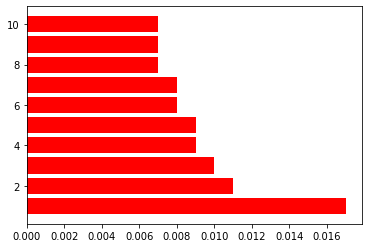

[['0.017*"people" ', ' 0.011*"government" ', ' 0.010*"family" ', ' 0.009*"great" ', ' 0.009*"thing" ', ' 0.008*"lot" ', ' 0.008*"suggestion" ', ' 0.007*"khadi" ', ' 0.007*"kid" ', ' 0.007*"cleanliness"'], ['0.011*"people" '], ['0.009*"people" '], ['0.008*"people" '], ['0.007*"people" '], ['0.007*"people" '], ['0.006*"thing" '], ['0.006*"people" '], ['0.006*"people" '], ['0.006*"people" ']]
70
[0.012, 0.01, 0.009, 0.008, 0.008, 0.007, 0.007, 0.006, 0.006, 0.006, 0.008, 0.006, 0.006, 0.005, 0.005, 0.005, 0.005, 0.005, 0.005]
[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 1, 1, 1, 1, 1, 1, 1, 1, 1]


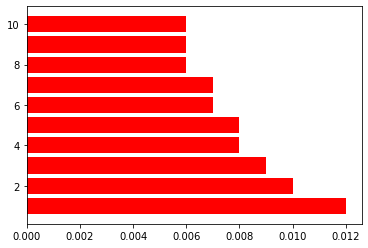

[['0.012*"farmer" ', ' 0.010*"poor" ', ' 0.009*"brother" ', ' 0.008*"government" ', ' 0.008*"opportunity" ', ' 0.007*"bank" ', ' 0.007*"youth" ', ' 0.006*"people" ', ' 0.006*"sister" ', ' 0.006*"nation"'], ['0.008*"farmer" '], ['0.006*"poor" '], ['0.006*"farmer" '], ['0.005*"farmer" '], ['0.005*"farmer" '], ['0.005*"farmer" '], ['0.005*"farmer" '], ['0.005*"farmer" '], ['0.005*"farmer" ']]
71
[0.015, 0.013, 0.011, 0.01, 0.01, 0.009, 0.009, 0.008, 0.007, 0.007, 0.008, 0.007, 0.007, 0.006, 0.006, 0.005, 0.005, 0.005, 0.005]
[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 1, 1, 1, 1, 1, 1, 1, 1, 1]


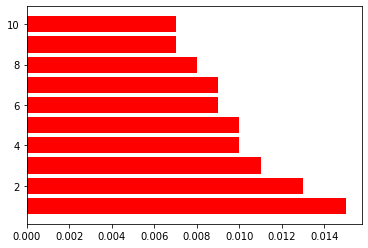

[['0.015*"government" ', ' 0.013*"suggestion" ', ' 0.011*"village" ', ' 0.010*"work" ', ' 0.010*"road" ', ' 0.009*"people" ', ' 0.009*"safety" ', ' 0.008*"accident" ', ' 0.007*"brother" ', ' 0.007*"state"'], ['0.008*"government" '], ['0.007*"suggestion" '], ['0.007*"government" '], ['0.006*"work" '], ['0.006*"government" '], ['0.005*"government" '], ['0.005*"government" '], ['0.005*"government" '], ['0.005*"government" ']]
72
[0.023, 0.017, 0.017, 0.011, 0.009, 0.009, 0.009, 0.008, 0.008, 0.008, 0.01, 0.01, 0.01, 0.01, 0.008, 0.008, 0.008, 0.005, 0.004]
[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 1, 1, 1, 1, 1, 1, 1, 1, 1]


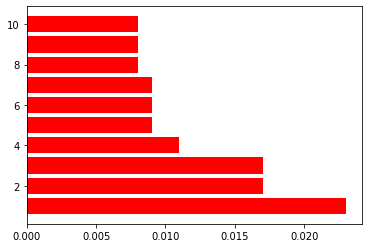

[['0.023*"yoga" ', ' 0.017*"people" ', ' 0.017*"water" ', ' 0.011*"time" ', ' 0.009*"entire" ', ' 0.009*"government" ', ' 0.009*"scheme" ', ' 0.008*"beti" ', ' 0.008*"work" ', ' 0.008*"rain"'], ['0.010*"yoga" '], ['0.010*"yoga" '], ['0.010*"yoga" '], ['0.010*"water" '], ['0.008*"yoga" '], ['0.008*"yoga" '], ['0.008*"people" '], ['0.005*"water" '], ['0.004*"yoga" ']]
73
[0.015, 0.011, 0.011, 0.01, 0.01, 0.009, 0.009, 0.009, 0.008, 0.008, 0.009, 0.007, 0.007, 0.007, 0.007, 0.005, 0.005, 0.005, 0.004]
[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 1, 1, 1, 1, 1, 1, 1, 1, 1]


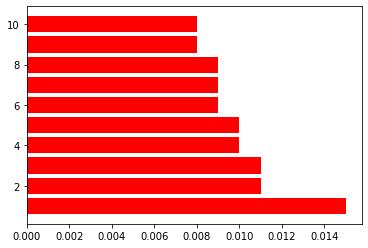

[['0.015*"life" ', ' 0.011*"nation" ', ' 0.011*"yoga" ', ' 0.010*"people" ', ' 0.010*"opportunity" ', ' 0.009*"failure" ', ' 0.009*"channel" ', ' 0.009*"farmer" ', ' 0.008*"animal" ', ' 0.008*"issue"'], ['0.009*"life" '], ['0.007*"life" '], ['0.007*"life" '], ['0.007*"life" '], ['0.007*"life" '], ['0.005*"nation" '], ['0.005*"life" '], ['0.005*"life" '], ['0.004*"yoga" ']]
74
[0.017, 0.014, 0.011, 0.011, 0.01, 0.009, 0.009, 0.008, 0.008, 0.007, 0.014, 0.009, 0.008, 0.008, 0.007, 0.007, 0.006, 0.006, 0.004]
[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 1, 1, 1, 1, 1, 1, 1, 1, 1]


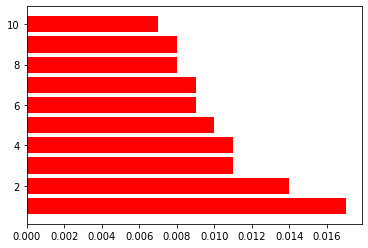

[['0.017*"people" ', ' 0.014*"life" ', ' 0.011*"work" ', ' 0.011*"nepal" ', ' 0.010*"indian" ', ' 0.009*"memorial" ', ' 0.009*"amidst" ', ' 0.008*"matter" ', ' 0.008*"time" ', ' 0.007*"daughter"'], ['0.014*"work" '], ['0.009*"people" '], ['0.008*"work" '], ['0.008*"people" '], ['0.007*"people" '], ['0.007*"people" '], ['0.006*"people" '], ['0.006*"people" '], ['0.004*"life" ']]
75
[0.051, 0.026, 0.022, 0.02, 0.02, 0.012, 0.011, 0.011, 0.008, 0.008, 0.038, 0.025, 0.022, 0.022, 0.022, 0.015, 0.012, 0.011, 0.01]
[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 1, 1, 1, 1, 1, 1, 1, 1, 1]


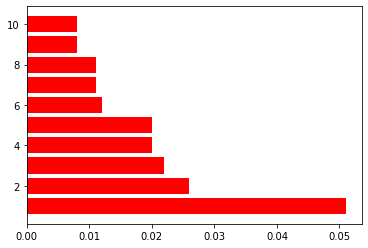

[['0.051*"farmer" ', ' 0.026*"government" ', ' 0.022*"land" ', ' 0.020*"village" ', ' 0.020*"law" ', ' 0.012*"brother" ', ' 0.011*"issue" ', ' 0.011*"sister" ', ' 0.008*"time" ', ' 0.008*"right"'], ['0.038*"farmer" '], ['0.025*"farmer" '], ['0.022*"farmer" '], ['0.022*"farmer" '], ['0.022*"farmer" '], ['0.015*"farmer" '], ['0.012*"farmer" '], ['0.011*"farmer" '], ['0.010*"farmer" ']]
76
[0.04, 0.021, 0.013, 0.012, 0.01, 0.01, 0.009, 0.008, 0.008, 0.008, 0.023, 0.021, 0.019, 0.015, 0.013, 0.009, 0.008, 0.006, 0.004]
[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 1, 1, 1, 1, 1, 1, 1, 1, 1]


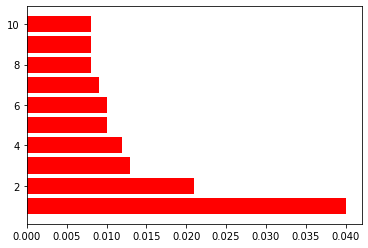

[['0.040*"exam" ', ' 0.021*"friend" ', ' 0.013*"life" ', ' 0.012*"child" ', ' 0.010*"think" ', ' 0.010*"time" ', ' 0.009*"student" ', ' 0.008*"good" ', ' 0.008*"know" ', ' 0.008*"faith"'], ['0.023*"exam" '], ['0.021*"exam" '], ['0.019*"exam" '], ['0.015*"exam" '], ['0.013*"exam" '], ['0.009*"exam" '], ['0.008*"exam" '], ['0.006*"exam" '], ['0.004*"exam" ']]
77
[0.02, 0.019, 0.011, 0.009, 0.008, 0.008, 0.008, 0.008, 0.008, 0.008, 0.012, 0.011, 0.009, 0.009, 0.008, 0.007, 0.007, 0.006, 0.004]
[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 1, 1, 1, 1, 1, 1, 1, 1, 1]


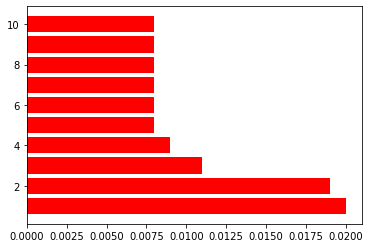

[['0.020*"question" ', ' 0.019*"barack" ', ' 0.011*"people" ', ' 0.009*"think" ', ' 0.008*"child" ', ' 0.008*"obama" ', ' 0.008*"ble" ', ' 0.008*"hon" ', ' 0.008*"shri" ', ' 0.008*"prime"'], ['0.012*"barack" '], ['0.011*"question" '], ['0.009*"question" '], ['0.009*"question" '], ['0.008*"barack" '], ['0.007*"question" '], ['0.007*"barack" '], ['0.006*"barack" '], ['0.004*"barack" ']]
78
[0.013, 0.011, 0.01, 0.01, 0.01, 0.009, 0.008, 0.007, 0.007, 0.007, 0.006, 0.006, 0.006, 0.006, 0.006, 0.005, 0.005, 0.003, 0.003]
[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 1, 1, 1, 1, 1, 1, 1, 1, 1]


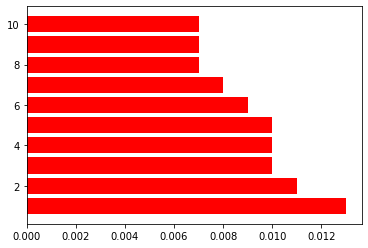

[['0.013*"drug" ', ' 0.011*"child" ', ' 0.010*"concern" ', ' 0.010*"life" ', ' 0.010*"addiction" ', ' 0.009*"time" ', ' 0.008*"people" ', ' 0.007*"minister" ', ' 0.007*"menace" ', ' 0.007*"want"'], ['0.006*"drug" '], ['0.006*"drug" '], ['0.006*"drug" '], ['0.006*"drug" '], ['0.006*"child" '], ['0.005*"drug" '], ['0.005*"drug" '], ['0.003*"people" '], ['0.003*"drug" ']]
79
[0.02, 0.013, 0.011, 0.01, 0.01, 0.008, 0.008, 0.007, 0.007, 0.007, 0.011, 0.01, 0.009, 0.008, 0.008, 0.006, 0.006, 0.006, 0.006]
[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 1, 1, 1, 1, 1, 1, 1, 1, 1]


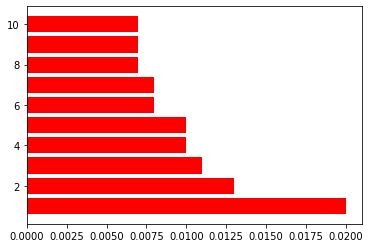

[['0.020*"people" ', ' 0.013*"time" ', ' 0.011*"government" ', ' 0.010*"poor" ', ' 0.010*"good" ', ' 0.008*"thing" ', ' 0.008*"talk" ', ' 0.007*"life" ', ' 0.007*"work" ', ' 0.007*"cleanliness"'], ['0.011*"people" '], ['0.010*"people" '], ['0.009*"people" '], ['0.008*"time" '], ['0.008*"people" '], ['0.006*"people" '], ['0.006*"people" '], ['0.006*"people" '], ['0.006*"people" ']]
80
[0.025, 0.015, 0.014, 0.013, 0.01, 0.01, 0.009, 0.009, 0.009, 0.008, 0.013, 0.012, 0.011, 0.01, 0.009, 0.009, 0.008, 0.008, 0.008]
[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 1, 1, 1, 1, 1, 1, 1, 1, 1]


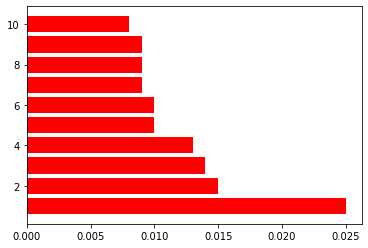

[['0.025*"nation" ', ' 0.015*"thought" ', ' 0.014*"suggestion" ', ' 0.013*"people" ', ' 0.010*"brother" ', ' 0.010*"strength" ', ' 0.009*"sheep" ', ' 0.009*"khaadi" ', ' 0.009*"believe" ', ' 0.008*"cub"'], ['0.013*"nation" '], ['0.012*"nation" '], ['0.011*"nation" '], ['0.010*"nation" '], ['0.009*"nation" '], ['0.009*"nation" '], ['0.008*"nation" '], ['0.008*"nation" '], ['0.008*"nation" ']]


In [ ]:
load()

In [ ]:
import nltk
nltk.download('brown')
nltk.download('wordnet')

[nltk_data] Downloading package brown to /root/nltk_data...
[nltk_data]   Unzipping corpora/brown.zip.
[nltk_data] Downloading package wordnet to /root/nltk_data...
[nltk_data]   Unzipping corpora/wordnet.zip.


True

In [ ]:
nltk.download('punkt')

[nltk_data] Downloading package punkt to /root/nltk_data...
[nltk_data]   Unzipping tokenizers/punkt.zip.


True

In [ ]:
word = ["Farmer"]
import nltk


def word_freq(text, word):
  textToken = nltk.word_tokenize(text)
  #print(textToken)
  counts = nltk.FreqDist(textToken)
  #print(counts[word])
  #print(counts[word]/len(textToken))
  return [counts[x]/len(textToken) for x in word]







In [ ]:
def df_wf():
  df = pd.read_csv('MKB.csv')
  ls = []
  for i in range(len(df)):
    temp = word_freq(df['Cleaned_content'][i], ["farmer", "corona","lockdown"])
    ls.append([df['Episode'][i], temp])
  
  return ls


In [ ]:
myLS = df_wf()

In [ ]:
myLS


[[20211024, [0.0, 0.0004478280340349306, 0.0]],
 [20210926, [0.0, 0.0015329586101175269, 0.0]],
 [20210829, [0.0, 0.00044682752457551384, 0.0]],
 [20210725, [0.0, 0.0014218009478672985, 0.0]],
 [20210627, [0.0, 0.008450704225352112, 0.0]],
 [20210530, [0.0, 0.008067473414008068, 0.0003667033370003667]],
 [20210425, [0.0, 0.00975816716164616, 0.0]],
 [20210328, [0.0, 0.001996007984031936, 0.0]],
 [20210228, [0.0005081300813008131, 0.003556910569105691, 0.0]],
 [20210131, [0.0, 0.003779697624190065, 0.0005399568034557236]],
 [20201227, [0.0, 0.002891844997108155, 0.0]],
 [20201129,
  [0.004707112970711297, 0.0036610878661087866, 0.0005230125523012552]],
 [20201025,
  [0.00048638132295719845, 0.0009727626459143969, 0.0024319066147859923]],
 [20200927,
  [0.003979307600477517, 0.0015917230401910067, 0.0007958615200955034]],
 [20200830,
  [0.000536480686695279, 0.003218884120171674, 0.001072961373390558]],
 [20200726, [0.0, 0.005150554675118859, 0.0]],
 [20200628,
  [0.0009930486593843098, 

In [ ]:
import matplotlib.pyplot as plt


df2 = pd.DataFrame(myLS)

In [ ]:
df3["farmer"] = df3["farmer"].apply(lambda x: x*x)
df3["corona"] = df3["corona"].apply(lambda x: x*x)
df3["lockdown"] = df3["lockdown"].apply(lambda x: x*x)

In [ ]:
df3 = pd.DataFrame(df2[1].to_list(), columns=["farmer", "corona","lockdown"])

In [ ]:
df2.head()

,0,1
0,20211024,"[0.0, 0.0004478280340349306, 0.0]"
1,20210926,"[0.0, 0.0015329586101175269, 0.0]"
2,20210829,"[0.0, 0.00044682752457551384, 0.0]"
3,20210725,"[0.0, 0.0014218009478672985, 0.0]"
4,20210627,"[0.0, 0.008450704225352112, 0.0]"


In [ ]:
df3

,farmer,corona,lockdown
0,0.0,0.000448,0.0
1,0.0,0.001533,0.0
2,0.0,0.000447,0.0
3,0.0,0.001422,0.0
4,0.0,0.008451,0.0
...,...,...,...
76,0.0,0.000000,0.0
77,0.0,0.000000,0.0
78,0.0,0.000000,0.0
79,0.0,0.000000,0.0


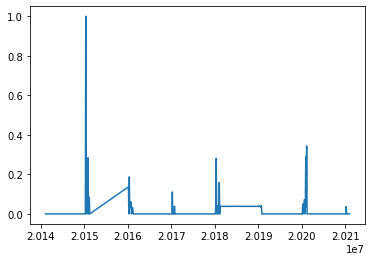

In [ ]:
plt.plot(df2[0], df2[1])

In [ ]:
df2.head(20)

,0,1
0,20211024,0.000000
1,20210926,0.000000
2,20210829,0.000000
3,20210725,0.000000
4,20210627,0.000000
5,20210530,0.000000
6,20210425,0.000000
7,20210328,0.000000
8,20210228,0.037112
9,20210131,0.000000


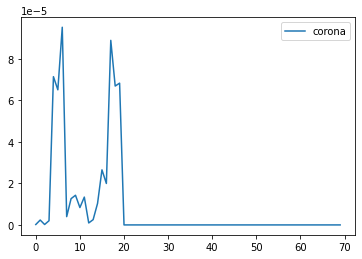

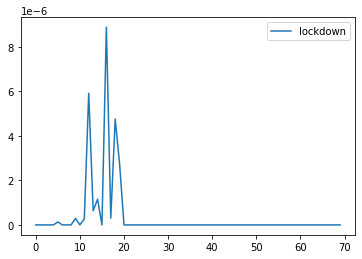

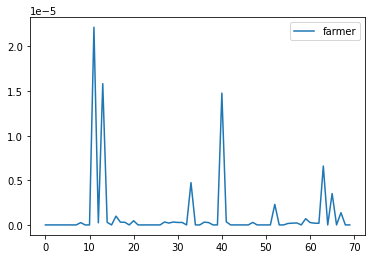

In [ ]:
df3.iloc[:70].plot(y=1)
df3.iloc[:70].plot(y=2)
df3.iloc[:70].plot(y=0)

In [ ]:
test_df = pd.read_csv('cleaned_tweets48.csv')

In [ ]:
test_df

,Unnamed: 0,id,date,content
0,1452749734716661762,1452749734716661762,2021-10-24,mannkibaat via namo app
1,1452725732002697219,1452725732002697219,2021-10-24,mannkibaat pmmodi mygovindia stand india gover...
2,1452720861367078912,1452720861367078912,2021-10-24,local mannkibaat httpstcoagncronqjh
3,1452720388371357699,1452720388371357699,2021-10-24,javedmansari langamahesh nobody bjp would want...
4,1452713887451607044,1452713887451607044,2021-10-24,listened hon pm shrinarendramodi ji mannkibaat...
...,...,...,...,...
160183,517902912857460737,517902912857460737,2014-10-03,billion population get hear modi air oath cere...
160184,517900645626421248,517900645626421248,2014-10-03,live streaming narendramodi speech mannkibaat ...
160185,517900128561004544,517900128561004544,2014-10-03,rj namo mannkibaat airnewsalerts
160186,517881722302513152,517881722302513152,2014-10-03,listen mannkibaat stations narendramodi


In [ ]:
test_df.drop('Unnamed: 0', axis = 1,inplace = True)

In [ ]:
my_df = list(test_df.groupby('date')['content'])

In [ ]:
my_df = pd.DataFrame(my_df)

In [ ]:
my_df

,0,1
0,2014-10-03,160080 check honorable prime minister naren...
1,2014-11-02,158079 listen mere mannkibaat ahealthymind ...
2,2014-12-14,156078 rupee hs finally crossd finmin jhoot...
3,2015-01-27,154077 namastepotus mannkibaat as...
4,2015-02-22,152076 indianexpress mediavsindia torture t...
...,...,...
76,2021-06-27,8004 narendramodi really wanderlust guy...
77,2021-07-25,6003 outstanding seeing rigorous effort got...
78,2021-08-29,4002 pmoindia narendramodi kirenrijiju pls ...
79,2021-09-26,2001 httweets brought back shall spread ...


In [ ]:
type(my_df[1][0])

pandas.core.series.Series

In [ ]:
tweets_wf = {}
new_tweets = test_df.groupby('date')['content'].apply(list)
for r in new_tweets.index:
  tweets_wf[r] = " ".join(new_tweets[r])
tweets_wf

{'2014-10-03': 'check honorable prime minister narendramodi saying apne mannkibaat myfm httpstco  start relating expressions people smileys mannkibaat  ye akashvaani hai aur main narendra modi bol raha hu mannkibaat httptco  mannkibaat media say reaching people govt speaks government procurers  first radio addressmannkibaat pm modi says nation belongs people govtnamo httptco  friends ke papa ke acchedin aa gaye sal se pade hue radio ek hi din bik gaye wahh mannkibaat  appreciating mannkibaat modikesaath httptco  urge people share details inspiring incidents share country modi mannkibaat jaihonamo radioaddress  speciallyabled children responsibility whole society modi mannkibaat jaihonamo radioaddress  understand better amp integrate strengths lacking strength mannkibaat jaihonamo radioaddress  mannkibaat pm shri narendra modi talks people india october httpstcoermjbamnbc  lahu nahi doodh ki nadiyan bahen narendramodi sushmaswaraj amitshahoffice cullinginmosque mannkibaat blrcitypolice 

In [ ]:
t = []
for k,v in tweets_wf.items():
  t.append([k,v])

In [ ]:
t

[['2014-10-03',
  'check honorable prime minister narendramodi saying apne mannkibaat myfm httpstco  start relating expressions people smileys mannkibaat  ye akashvaani hai aur main narendra modi bol raha hu mannkibaat httptco  mannkibaat media say reaching people govt speaks government procurers  first radio addressmannkibaat pm modi says nation belongs people govtnamo httptco  friends ke papa ke acchedin aa gaye sal se pade hue radio ek hi din bik gaye wahh mannkibaat  appreciating mannkibaat modikesaath httptco  urge people share details inspiring incidents share country modi mannkibaat jaihonamo radioaddress  speciallyabled children responsibility whole society modi mannkibaat jaihonamo radioaddress  understand better amp integrate strengths lacking strength mannkibaat jaihonamo radioaddress  mannkibaat pm shri narendra modi talks people india october httpstcoermjbamnbc  lahu nahi doodh ki nadiyan bahen narendramodi sushmaswaraj amitshahoffice cullinginmosque mannkibaat blrcitypoli

In [ ]:
my_df = pd.DataFrame(t)

In [ ]:
my_df

,0,1
0,2014-10-03,check honorable prime minister narendramodi sa...
1,2014-11-02,listen mere mannkibaat ahealthymind myth garba...
2,2014-12-14,rupee hs finally crossd finmin jhoothly agemr ...
3,2015-01-27,namastepotus mannkibaat asked httpstco war en...
4,2015-02-22,indianexpress mediavsindia torture tribals til...
...,...,...
76,2021-06-27,narendramodi really wanderlust guy mannkibaat ...
77,2021-07-25,outstanding seeing rigorous effort got idea sh...
78,2021-08-29,pmoindia narendramodi kirenrijiju pls look law...
79,2021-09-26,httweets brought back shall spread mannkibaat ...


In [ ]:
my_df = my_df.rename(columns={0:'date',1:'ep'})

In [ ]:
def df_wf_t(df):
  #df = pd.read_csv('MKB.csv')
  ls = []
  for i in range(len(df)):
    temp = word_freq(df['ep'][i], ["farmer", "corona","lockdown"])
    ls.append([df['date'][i], temp])
  
  return ls


In [ ]:
tweet_ls = df_wf_t(my_df)

In [ ]:
tweet_ls

[['2014-10-03', [0.0, 0.0, 0.0]],
 ['2014-11-02', [5.43685097591475e-05, 0.0, 0.0]],
 ['2014-12-14', [0.0, 0.0, 0.0]],
 ['2015-01-27', [0.0, 0.0, 0.0]],
 ['2015-02-22', [0.0001223091976516634, 0.0, 0.0]],
 ['2015-03-22', [0.005241291147331416, 0.0, 0.0]],
 ['2015-04-26', [0.00038749677086024286, 0.0, 0.0]],
 ['2015-05-31', [6.116582053948254e-05, 0.0, 0.0]],
 ['2015-06-28', [6.0117830948659375e-05, 0.0, 0.0]],
 ['2015-07-26', [6.307954330410648e-05, 0.0, 0.0]],
 ['2015-08-30', [0.0007379619949572597, 0.0, 0.0]],
 ['2015-09-20', [6.485084306095979e-05, 0.0, 0.0]],
 ['2015-10-25', [0.0, 0.0, 0.0]],
 ['2015-11-29', [0.00013508949679162446, 0.0, 0.0]],
 ['2015-12-27', [0.0, 0.0, 0.0]],
 ['2016-01-31', [0.00046985121378230227, 0.0, 0.0]],
 ['2016-02-28', [5.363080553469913e-05, 0.0, 0.0]],
 ['2016-03-27', [0.0017643710870802504, 0.0, 0.0]],
 ['2016-04-24', [5.4007344998919854e-05, 0.0, 0.0]],
 ['2016-05-22', [0.0, 0.0, 0.0]],
 ['2016-06-26', [5.9584102961329916e-05, 0.0, 0.0]],
 ['2016-07-3

In [ ]:
df4 = pd.DataFrame(tweet_ls)
df5 = pd.DataFrame(df2[1].to_list(), columns=["farmer", "corona","lockdown"])

In [ ]:
df5.head()

,farmer,corona,lockdown
0,0.0,0.000448,0.0
1,0.0,0.001533,0.0
2,0.0,0.000447,0.0
3,0.0,0.001422,0.0
4,0.0,0.008451,0.0


In [ ]:
df5.iloc[:].plot(y=1)

NameError: ignored

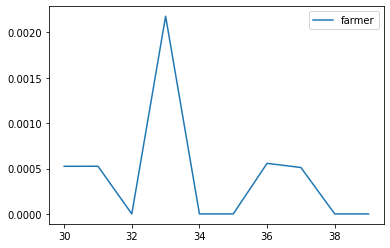

In [ ]:
df5.iloc[:].plot(y=0)

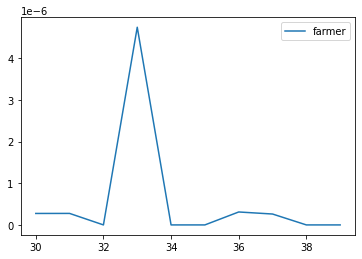

In [ ]:
df3.iloc[30:40].plot(y=0)